# Problem Statment

In the telecommunication industry, customers tend to change operators if not provided with attractive schemes and offers. 
It is very important for any telecom operator to prevent the present customers from churning to other operators.
In this highly competitive market, telecom indutry experiences an average of 15 -25 % annual churn rate.
Given the fact it costs 5-10 times more to acquire a new customer than to retain an existing customer.
Customer retention has now become even more important than customer acquistion.
As Data scientist we have to build an ML model which can predict if the customer will churn or not in a particular month based on the past data for the high value customers.


In [128]:
import numpy as np
import pandas as pd
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns',None)
import warnings
warnings.filterwarnings('ignore')
import sklearn.metrics as metrics

In [129]:
data = pd.read_csv(r'C:\Users\pc\OneDrive\Desktop\Kaggle_project\train.csv')
unseen= pd.read_csv(r'C:\Users\pc\OneDrive\Desktop\Kaggle_project\test.csv')
data_dict= pd.read_csv(r'C:\Users\pc\OneDrive\Desktop\Kaggle_project\data_dictionary.csv')

In [131]:
print(data.shape)
print(unseen.shape)
print(data_dict.shape)

(69999, 172)
(30000, 171)
(36, 2)


In [132]:
data_dict

,Acronyms,Description
0,CIRCLE_ID,Telecom circle area to which the customer belo...
1,LOC,Local calls within same telecom circle
2,STD,STD calls outside the calling circle
3,IC,Incoming calls
4,OG,Outgoing calls
5,T2T,Operator T to T ie within same operator mobile...
6,T2M,Operator T to other operator mobile
7,T2O,Operator T to other operator fixed line
8,T2F,Operator T to fixed lines of T
9,T2C,Operator T to its own call center


In [133]:
data.head()

,id,circle_id,loc_og_t2o_mou,std_og_t2o_mou,loc_ic_t2o_mou,last_date_of_month_6,last_date_of_month_7,last_date_of_month_8,arpu_6,arpu_7,arpu_8,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_t2c_mou_6,std_og_t2c_mou_7,std_og_t2c_mou_8,std_og_mou_6,std_og_mou_7,std_og_mou_8,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,og_others_6,og_others_7,og_others_8,total_og_mou_6,total_og_mou_7,total_og_mou_8,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_t2o_mou_6,std_ic_t2o_mou_7,std_ic_t2o_mou_8,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,ic_others_6,ic_others_7,ic_others_8,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,date_of_last_rech_6,date_of_last_rech_7,date_of_last_rech_8,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,date_of_last_rech_data_6,date_of_last_rech_data_7,date_of_last_rech_data_8,total_rech_data_6,total_rech_data_7,total_rech_data_8,max_rech_data_6,max_rech_data_7,max_rech_data_8,count_rech_2g_6,count_rech_2g_7,count_rech_2g_8,count_rech_3g_6,count_rech_3g_7,count_rech_3g_8,av_rech_amt_data_6,av_rech_amt_data_7,av_rech_amt_data_8,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,arpu_3g_6,arpu_3g_7,arpu_3g_8,arpu_2g_6,arpu_2g_7,arpu_2g_8,night_pck_user_6,night_pck_user_7,night_pck_user_8,monthly_2g_6,monthly_2g_7,monthly_2g_8,sachet_2g_6,sachet_2g_7,sachet_2g_8,monthly_3g_6,monthly_3g_7,monthly_3g_8,sachet_3g_6,sachet_3g_7,sachet_3g_8,fb_user_6,fb_user_7,fb_user_8,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,churn_probability
0,0,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,31.277,87.009,7.527,48.58,124.38,1.29,32.24,96.68,2.33,0.00,0.0,0.0,0.00,0.0,0.00,2.23,0.00,0.28,5.29,16.04,2.33,0.00,0.00,0.00,0.00,0.00,0.00,7.53,16.04,2.61,46.34,124.38,1.01,18.75,80.61,0.0,0.00,0.0,0.0,0.0,0.0,0.0,65.09,204.99,1.01,0.0,0.0,0.0,8.20,0.63,0.00,0.38,0.0,0.0,81.21,221.68,3.63,2.43,3.68,7.79,0.83,21.08,16.91,0.00,0.00,0.00,3.26,24.76,24.71,0.00,7.61,0.21,7.46,19.96,14.96,0.0,0.0,0.0,0.0,0.0,0.0,7.46,27.58,15.18,11.84,53.04,40.56,0.0,0.0,0.66,0.0,0.0,0.0,1.11,0.69,0.00,3,2,2,77,65,10,65,65,10,6/22/2014,7/10/2014,8/24/2014,65,65,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.00,0.00,0.0,0.00,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,1958,0.0,0.0,0.0,0
1,1,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,0.000,122.787,42.953,0.00,0.00,0.00,0.00,25.99,30.89,0.00,0.0,0.0,0.00,0.0,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,22.01,29.79,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.00,0.00,0.00,0.0,0.0,0.0,0.00,30.73,31.66,0.00,0.0,0.0,0.00,30.73,31.66,1.68,19.09,10.53,1.41,18.68,11.09,0.35,1.66,3.40,3.44,39.44,25.03,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.00,0.00,3.44,39.44,25.04,0.0,0.0,0.01,0.0,0.0,0.0,0.00,0.00,0.00,3,4,5,0,145,50,0,145,50,6/12/2014,7/10/2014,8/26/2014,0,0,0,NaN,7/8/2014,NaN,NaN,1.0,NaN,NaN,145.0,NaN,NaN,0.0,NaN,NaN,1.0,NaN,Na

## finding High-value customer

In [134]:
#Finding columns with recharge info as total recharge amount is to be used for High Value Customer Filter.

all_rech_vars = [col for col in data.columns if '_rech_' in col]
print(all_rech_vars)

['total_rech_num_6', 'total_rech_num_7', 'total_rech_num_8', 'total_rech_amt_6', 'total_rech_amt_7', 'total_rech_amt_8', 'max_rech_amt_6', 'max_rech_amt_7', 'max_rech_amt_8', 'date_of_last_rech_6', 'date_of_last_rech_7', 'date_of_last_rech_8', 'date_of_last_rech_data_6', 'date_of_last_rech_data_7', 'date_of_last_rech_data_8', 'total_rech_data_6', 'total_rech_data_7', 'total_rech_data_8', 'max_rech_data_6', 'max_rech_data_7', 'max_rech_data_8', 'count_rech_2g_6', 'count_rech_2g_7', 'count_rech_2g_8', 'count_rech_3g_6', 'count_rech_3g_7', 'count_rech_3g_8', 'av_rech_amt_data_6', 'av_rech_amt_data_7', 'av_rech_amt_data_8']


In [135]:
#Derieving Total Data Recharge Amounts column

data["total_rech_data_amt_6"] = data["total_rech_data_6"]  * data['av_rech_amt_data_6']
data["total_rech_data_amt_7"] = data["total_rech_data_7"]  * data['av_rech_amt_data_7']
data["total_rech_data_amt_8"] = data["total_rech_data_8"]  * data['av_rech_amt_data_8']

In [136]:
# Finding Average recharge amount for good phase i.e 6th and 7th month
good_phase_avg_rech_amt = (data['total_rech_amt_6'].fillna(0) + data['total_rech_amt_7'].fillna(0) + 
                               data['total_rech_data_amt_6'].fillna(0) + data['total_rech_data_amt_7'].fillna(0) ) / 2

# 70 percentile of the good_phase_average_rech_amt data
good_phase_avg_rech_amt_70 = np.percentile(good_phase_avg_rech_amt, 70.0)
print(f'70 Percentile of recharge amount is : {good_phase_avg_rech_amt_70}')

70 Percentile of recharge amount is : 477.5


In [137]:
# Keeping high value customer data
High_val_cust_data = data[good_phase_avg_rech_amt >= good_phase_avg_rech_amt_70]
High_val_cust_data.head()

,id,circle_id,loc_og_t2o_mou,std_og_t2o_mou,loc_ic_t2o_mou,last_date_of_month_6,last_date_of_month_7,last_date_of_month_8,arpu_6,arpu_7,arpu_8,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_t2c_mou_6,std_og_t2c_mou_7,std_og_t2c_mou_8,std_og_mou_6,std_og_mou_7,std_og_mou_8,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,og_others_6,og_others_7,og_others_8,total_og_mou_6,total_og_mou_7,total_og_mou_8,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_t2o_mou_6,std_ic_t2o_mou_7,std_ic_t2o_mou_8,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,ic_others_6,ic_others_7,ic_others_8,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,date_of_last_rech_6,date_of_last_rech_7,date_of_last_rech_8,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,date_of_last_rech_data_6,date_of_last_rech_data_7,date_of_last_rech_data_8,total_rech_data_6,total_rech_data_7,total_rech_data_8,max_rech_data_6,max_rech_data_7,max_rech_data_8,count_rech_2g_6,count_rech_2g_7,count_rech_2g_8,count_rech_3g_6,count_rech_3g_7,count_rech_3g_8,av_rech_amt_data_6,av_rech_amt_data_7,av_rech_amt_data_8,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,arpu_3g_6,arpu_3g_7,arpu_3g_8,arpu_2g_6,arpu_2g_7,arpu_2g_8,night_pck_user_6,night_pck_user_7,night_pck_user_8,monthly_2g_6,monthly_2g_7,monthly_2g_8,sachet_2g_6,sachet_2g_7,sachet_2g_8,monthly_3g_6,monthly_3g_7,monthly_3g_8,sachet_3g_6,sachet_3g_7,sachet_3g_8,fb_user_6,fb_user_7,fb_user_8,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,churn_probability,total_rech_data_amt_6,total_rech_data_amt_7,total_rech_data_amt_8
4,4,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,240.708,128.191,101.565,21.28,4.83,6.13,56.99,38.11,9.63,53.64,0.0,0.0,15.73,0.0,0.0,10.16,4.83,6.13,36.74,19.88,4.61,11.99,1.23,5.01,0.0,9.85,0.00,58.91,25.94,15.76,0.0,0.0,0.0,4.35,0.00,0.00,0.0,0.0,0.00,0.0,0.0,0.0,4.35,0.00,0.00,0.0,0.0,0.0,0.00,17.00,0.00,0.0,0.0,0.0,63.26,42.94,15.76,5.44,1.39,2.66,10.58,4.33,19.49,5.51,3.63,6.14,21.54,9.36,28.31,0.0,0.0,0.0,0.00,0.00,0.00,0.00,0.00,0.0,0.0,0.0,0.0,0.00,0.00,0.00,21.54,9.36,28.31,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,13,10,8,290,136,122,50,41,30,6/25/2014,7/26/2014,8/30/2014,25,10,30,6/25/2014,7/23/2014,8/20/2014,7.0,7.0,6.0,25.0,41.0,25.0,7.0,6.0,6.0,0.0,1.0,0.0,175.0,191.0,142.0,390.80,308.89,213.47,0.0,0.00,0.00,0.00,35.00,0.00,0.00,35.12,0.00,0.0,0.0,0.0,0,0,0,7,6,6,0,0,0,0,1,0,1.0,1.0,1.0,647,0.0,0.00,0.00,0,1225.0,1337.0,852.0
15,15,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,580.549,377.294,338.286,10.43,24.99,194.43,317.11,341.79,197.09,0.00,0.0,0.0,0.00,0.0,0.0,10.43,24.99,194.43,313.76,330.88,185.88,3.26,10.91,4.94,0.0,0.00,0.00,327.46,366.79,385.26,0.0,0.0,0.0,0.00,0.00,0.00,0.0,0.0,6.26,0.0,0.0,0.0,0.00,0.00,6.26,0.0,0.0,0.0,0.08,0.00,0.00,0.1,0.0,0.0,327.64,366.79,391.53,13.86,20.18,335.43,219.31,754.24,285.63,0.00,1.93,8.88,233.18,776.36,629.94,0.0,0.0,0.0,0.00,0.00,0.00,0.00,1.03,0.0,0.0,0.0,0.0,0.00,1.03,0.00,233.18,777.39,629.94,0.00,0

In [138]:
High_val_cust_data.shape

(21013, 175)

In [139]:
High_val_cust_data['churn_probability'].value_counts()

0    19274
1     1739
Name: churn_probability, dtype: int64

# Data Cleaning

In [140]:
#Removing List of columns with only 1 unqiue value

column_list_U = High_val_cust_data.loc[:,High_val_cust_data.apply(pd.Series.nunique) == 1]
column_list_U.head(5)

,circle_id,loc_og_t2o_mou,std_og_t2o_mou,loc_ic_t2o_mou,last_date_of_month_6,last_date_of_month_7,last_date_of_month_8,std_og_t2c_mou_6,std_og_t2c_mou_7,std_og_t2c_mou_8,std_ic_t2o_mou_6,std_ic_t2o_mou_7,std_ic_t2o_mou_8
4,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,0.0,0.0,0.0,0.0,0.0,0.0
15,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,0.0,0.0,0.0,0.0,0.0,0.0
23,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,0.0,0.0,0.0,0.0,0.0,0.0
24,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,0.0,0.0,0.0,0.0,0.0,0.0
27,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,0.0,0.0,0.0,0.0,0.0,0.0


In [141]:
#Removing Columns with only 1 unique value.

High_val_cust_data = High_val_cust_data.loc[:,High_val_cust_data.apply(pd.Series.nunique) != 1]
High_val_cust_data.shape

(21013, 162)

In [142]:
# Checking object data type columns 
object_columns_data = High_val_cust_data.select_dtypes(include=['object'])
print(object_columns_data.iloc[0])

date_of_last_rech_6         6/25/2014
date_of_last_rech_7         7/26/2014
date_of_last_rech_8         8/30/2014
date_of_last_rech_data_6    6/25/2014
date_of_last_rech_data_7    7/23/2014
date_of_last_rech_data_8    8/20/2014
Name: 4, dtype: object


#### since these dates are not required for our analysis. hence removing from dataframe
- date_of_last_rech_6
- date_of_last_rech_7
- date_of_last_rech_8
- date_of_last_rech_data_6
- date_of_last_rech_data_7
- date_of_last_rech_data_8

In [143]:
High_val_cust_data=High_val_cust_data.drop(object_columns_data,axis=1)
High_val_cust_data.head()

,id,arpu_6,arpu_7,arpu_8,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_mou_6,std_og_mou_7,std_og_mou_8,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,og_others_6,og_others_7,og_others_8,total_og_mou_6,total_og_mou_7,total_og_mou_8,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,ic_others_6,ic_others_7,ic_others_8,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,total_rech_data_6,total_rech_data_7,total_rech_data_8,max_rech_data_6,max_rech_data_7,max_rech_data_8,count_rech_2g_6,count_rech_2g_7,count_rech_2g_8,count_rech_3g_6,count_rech_3g_7,count_rech_3g_8,av_rech_amt_data_6,av_rech_amt_data_7,av_rech_amt_data_8,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,arpu_3g_6,arpu_3g_7,arpu_3g_8,arpu_2g_6,arpu_2g_7,arpu_2g_8,night_pck_user_6,night_pck_user_7,night_pck_user_8,monthly_2g_6,monthly_2g_7,monthly_2g_8,sachet_2g_6,sachet_2g_7,sachet_2g_8,monthly_3g_6,monthly_3g_7,monthly_3g_8,sachet_3g_6,sachet_3g_7,sachet_3g_8,fb_user_6,fb_user_7,fb_user_8,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,churn_probability,total_rech_data_amt_6,total_rech_data_amt_7,total_rech_data_amt_8
4,4,240.708,128.191,101.565,21.28,4.83,6.13,56.99,38.11,9.63,53.64,0.0,0.0,15.73,0.0,0.0,10.16,4.83,6.13,36.74,19.88,4.61,11.99,1.23,5.01,0.0,9.85,0.00,58.91,25.94,15.76,0.0,0.0,0.0,4.35,0.00,0.00,0.0,0.0,0.00,4.35,0.00,0.00,0.0,0.0,0.0,0.00,17.00,0.00,0.0,0.0,0.0,63.26,42.94,15.76,5.44,1.39,2.66,10.58,4.33,19.49,5.51,3.63,6.14,21.54,9.36,28.31,0.0,0.0,0.0,0.00,0.00,0.00,0.00,0.00,0.0,0.00,0.00,0.00,21.54,9.36,28.31,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,13,10,8,290,136,122,50,41,30,25,10,30,7.0,7.0,6.0,25.0,41.0,25.0,7.0,6.0,6.0,0.0,1.0,0.0,175.0,191.0,142.0,390.80,308.89,213.47,0.0,0.00,0.00,0.00,35.00,0.00,0.00,35.12,0.00,0.0,0.0,0.0,0,0,0,7,6,6,0,0,0,0,1,0,1.0,1.0,1.0,647,0.0,0.00,0.00,0,1225.0,1337.0,852.0
15,15,580.549,377.294,338.286,10.43,24.99,194.43,317.11,341.79,197.09,0.00,0.0,0.0,0.00,0.0,0.0,10.43,24.99,194.43,313.76,330.88,185.88,3.26,10.91,4.94,0.0,0.00,0.00,327.46,366.79,385.26,0.0,0.0,0.0,0.00,0.00,0.00,0.0,0.0,6.26,0.00,0.00,6.26,0.0,0.0,0.0,0.08,0.00,0.00,0.1,0.0,0.0,327.64,366.79,391.53,13.86,20.18,335.43,219.31,754.24,285.63,0.00,1.93,8.88,233.18,776.36,629.94,0.0,0.0,0.0,0.00,0.00,0.00,0.00,1.03,0.0,0.00,1.03,0.00,233.18,777.39,629.94,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,5,3,4,654,400,652,250,250,250,0,150,250,1.0,NaN,1.0,154.0,NaN,154.0,1.0,NaN,1.0,0.0,NaN,0.0,154.0,NaN,154.0,260.42,0.00,354.35,0.0,0.00,0.00,0.00,NaN,0.00,164.75,NaN,28.80,0.0,NaN,0.0,1,0,1,0,0,0,0,0,0,0,0,0,1.0,NaN,1.0,602,0.0,0.00,0.00,0,154.0,NaN,154.0
23,23,1130.948,905.506,479.762,859.53,372.71,0.89,293.46,450.11,386.91,0.00,0.0,0.0,0.00,0.0,0.0,859.53,372.71,0.89,79.79,424.63,378.01,11.58,25.43,8.88,0.0,0.00,0.00,950.91,822.78,387.79,0.0,0.0,0.0,202.08,0.00,0.00,0.0,0.0,0.00,202.08,0.00,0.00,0.0,0.0,0.0,0.00,0.0

In [144]:
# checking shape again
High_val_cust_data.shape

(21013, 156)

# Missing Value analysis

In [145]:
# % of missing values
missing_data_percent = round(100*(High_val_cust_data.isnull().sum())/len(High_val_cust_data.index),2)
missing_data_percent

id                        0.00
arpu_6                    0.00
arpu_7                    0.00
arpu_8                    0.00
onnet_mou_6               1.89
onnet_mou_7               1.87
onnet_mou_8               3.91
offnet_mou_6              1.89
offnet_mou_7              1.87
offnet_mou_8              3.91
roam_ic_mou_6             1.89
roam_ic_mou_7             1.87
roam_ic_mou_8             3.91
roam_og_mou_6             1.89
roam_og_mou_7             1.87
roam_og_mou_8             3.91
loc_og_t2t_mou_6          1.89
loc_og_t2t_mou_7          1.87
loc_og_t2t_mou_8          3.91
loc_og_t2m_mou_6          1.89
loc_og_t2m_mou_7          1.87
loc_og_t2m_mou_8          3.91
loc_og_t2f_mou_6          1.89
loc_og_t2f_mou_7          1.87
loc_og_t2f_mou_8          3.91
loc_og_t2c_mou_6          1.89
loc_og_t2c_mou_7          1.87
loc_og_t2c_mou_8          3.91
loc_og_mou_6              1.89
loc_og_mou_7              1.87
loc_og_mou_8              3.91
std_og_t2t_mou_6          1.89
std_og_t

In [146]:
new_variables = missing_data_percent[missing_data_percent.le(40)].index
new_variables

Index(['id', 'arpu_6', 'arpu_7', 'arpu_8', 'onnet_mou_6', 'onnet_mou_7',
       'onnet_mou_8', 'offnet_mou_6', 'offnet_mou_7', 'offnet_mou_8',
       ...
       'monthly_3g_7', 'monthly_3g_8', 'sachet_3g_6', 'sachet_3g_7',
       'sachet_3g_8', 'aon', 'aug_vbc_3g', 'jul_vbc_3g', 'jun_vbc_3g',
       'churn_probability'],
      dtype='object', length=126)

In [147]:
#High value customer data after removing missing values and keeping the data with < 40%
High_val_cust_data_filter = High_val_cust_data[new_variables]
High_val_cust_data_filter.shape

(21013, 126)

In [148]:
# Dropping duplicate values in dataset, if exists any
High_val_cust_data_filter = High_val_cust_data_filter.drop_duplicates()
print(High_val_cust_data_filter.shape)

(21013, 126)


In [149]:
# check missing value again after dropping the columns
round(100*(High_val_cust_data_filter.isnull().sum())/len(High_val_cust_data_filter.index),2)

id                    0.00
arpu_6                0.00
arpu_7                0.00
arpu_8                0.00
onnet_mou_6           1.89
onnet_mou_7           1.87
onnet_mou_8           3.91
offnet_mou_6          1.89
offnet_mou_7          1.87
offnet_mou_8          3.91
roam_ic_mou_6         1.89
roam_ic_mou_7         1.87
roam_ic_mou_8         3.91
roam_og_mou_6         1.89
roam_og_mou_7         1.87
roam_og_mou_8         3.91
loc_og_t2t_mou_6      1.89
loc_og_t2t_mou_7      1.87
loc_og_t2t_mou_8      3.91
loc_og_t2m_mou_6      1.89
loc_og_t2m_mou_7      1.87
loc_og_t2m_mou_8      3.91
loc_og_t2f_mou_6      1.89
loc_og_t2f_mou_7      1.87
loc_og_t2f_mou_8      3.91
loc_og_t2c_mou_6      1.89
loc_og_t2c_mou_7      1.87
loc_og_t2c_mou_8      3.91
loc_og_mou_6          1.89
loc_og_mou_7          1.87
loc_og_mou_8          3.91
std_og_t2t_mou_6      1.89
std_og_t2t_mou_7      1.87
std_og_t2t_mou_8      3.91
std_og_t2m_mou_6      1.89
std_og_t2m_mou_7      1.87
std_og_t2m_mou_8      3.91
s

In [150]:
# drop rows with missing value NAN

High_val_cust_filter=High_val_cust_data_filter.dropna(axis=0).reset_index(drop=True)

In [151]:
# checking missing value % again after removing NAN values from rows
round(100*(High_val_cust_filter.isnull().sum())/len(High_val_cust_filter.index),2)

id                    0.0
arpu_6                0.0
arpu_7                0.0
arpu_8                0.0
onnet_mou_6           0.0
onnet_mou_7           0.0
onnet_mou_8           0.0
offnet_mou_6          0.0
offnet_mou_7          0.0
offnet_mou_8          0.0
roam_ic_mou_6         0.0
roam_ic_mou_7         0.0
roam_ic_mou_8         0.0
roam_og_mou_6         0.0
roam_og_mou_7         0.0
roam_og_mou_8         0.0
loc_og_t2t_mou_6      0.0
loc_og_t2t_mou_7      0.0
loc_og_t2t_mou_8      0.0
loc_og_t2m_mou_6      0.0
loc_og_t2m_mou_7      0.0
loc_og_t2m_mou_8      0.0
loc_og_t2f_mou_6      0.0
loc_og_t2f_mou_7      0.0
loc_og_t2f_mou_8      0.0
loc_og_t2c_mou_6      0.0
loc_og_t2c_mou_7      0.0
loc_og_t2c_mou_8      0.0
loc_og_mou_6          0.0
loc_og_mou_7          0.0
loc_og_mou_8          0.0
std_og_t2t_mou_6      0.0
std_og_t2t_mou_7      0.0
std_og_t2t_mou_8      0.0
std_og_t2m_mou_6      0.0
std_og_t2m_mou_7      0.0
std_og_t2m_mou_8      0.0
std_og_t2f_mou_6      0.0
std_og_t2f_m

In [152]:
High_val_cust_filter.shape

(19950, 126)

In [153]:
# dropping id column
High_val_cust_filter_WI =High_val_cust_filter.drop('id', axis=1)

In [154]:
High_val_cust_filter_WI.head()

,arpu_6,arpu_7,arpu_8,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_mou_6,std_og_mou_7,std_og_mou_8,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,og_others_6,og_others_7,og_others_8,total_og_mou_6,total_og_mou_7,total_og_mou_8,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,ic_others_6,ic_others_7,ic_others_8,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,monthly_2g_6,monthly_2g_7,monthly_2g_8,sachet_2g_6,sachet_2g_7,sachet_2g_8,monthly_3g_6,monthly_3g_7,monthly_3g_8,sachet_3g_6,sachet_3g_7,sachet_3g_8,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,churn_probability
0,240.708,128.191,101.565,21.28,4.83,6.13,56.99,38.11,9.63,53.64,0.0,0.0,15.73,0.0,0.0,10.16,4.83,6.13,36.74,19.88,4.61,11.99,1.23,5.01,0.0,9.85,0.00,58.91,25.94,15.76,0.0,0.0,0.0,4.35,0.00,0.00,0.0,0.0,0.00,4.35,0.00,0.00,0.0,0.0,0.0,0.00,17.00,0.00,0.0,0.0,0.0,63.26,42.94,15.76,5.44,1.39,2.66,10.58,4.33,19.49,5.51,3.63,6.14,21.54,9.36,28.31,0.0,0.0,0.0,0.00,0.00,0.00,0.00,0.00,0.0,0.00,0.00,0.00,21.54,9.36,28.31,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,13,10,8,290,136,122,50,41,30,25,10,30,390.80,308.89,213.47,0.0,0.00,0.00,0,0,0,7,6,6,0,0,0,0,1,0,647,0.0,0.00,0.00,0
1,580.549,377.294,338.286,10.43,24.99,194.43,317.11,341.79,197.09,0.00,0.0,0.0,0.00,0.0,0.0,10.43,24.99,194.43,313.76,330.88,185.88,3.26,10.91,4.94,0.0,0.00,0.00,327.46,366.79,385.26,0.0,0.0,0.0,0.00,0.00,0.00,0.0,0.0,6.26,0.00,0.00,6.26,0.0,0.0,0.0,0.08,0.00,0.00,0.1,0.0,0.0,327.64,366.79,391.53,13.86,20.18,335.43,219.31,754.24,285.63,0.00,1.93,8.88,233.18,776.36,629.94,0.0,0.0,0.0,0.00,0.00,0.00,0.00,1.03,0.0,0.00,1.03,0.00,233.18,777.39,629.94,0.00,0.0,0.0,0.0,0.0,0.0,0.0,0.00,0.0,5,3,4,654,400,652,250,250,250,0,150,250,260.42,0.00,354.35,0.0,0.00,0.00,1,0,1,0,0,0,0,0,0,0,0,0,602,0.0,0.00,0.00,0
2,1130.948,905.506,479.762,859.53,372.71,0.89,293.46,450.11,386.91,0.00,0.0,0.0,0.00,0.0,0.0,859.53,372.71,0.89,79.79,424.63,378.01,11.58,25.43,8.88,0.0,0.00,0.00,950.91,822.78,387.79,0.0,0.0,0.0,202.08,0.00,0.00,0.0,0.0,0.00,202.08,0.00,0.00,0.0,0.0,0.0,0.00,0.05,0.01,0.0,0.0,0.0,1152.99,822.83,387.81,233.28,117.63,30.39,123.78,278.49,148.83,34.31,52.08,23.66,391.38,448.21,202.89,0.0,0.0,0.0,207.03,0.00,0.00,0.00,0.00,0.0,207.03,0.00,0.00,598.54,448.36,203.29,0.13,0.0,0.0,0.0,0.0,0.0,0.0,0.15,0.4,26,19,10,1420,990,494,110,110,144,110,50,30,0.00,0.00,0.00,0.0,0.00,0.00,0,0,0,0,0,0,0,0,0,0,0,0,455,0.0,0.00,0.00,0
3,371.974,352.069,240.449,93.18,38.29,29.86,531.19,507.76,222.03,0.00,0.0,0.0,0.00,0.0,0.0,93.18,38.29,29.86,159.29,219.44,99.86,0.00,0.00,0.00,0.0,0.00,0.36,252.48,257.74,129.73,0.0,0.0,0.0,371.89,288.31,121.79,0.0,0.0,0.00,371.89,288.31,121.79,0.0,0.0,0.0,0.00,0.00,0.36,0.0,0.0,0.0,624.38,546.06,251.89,52.49,37.84,19.14,170.61,106.71,150.73,0.00,1.53,1.13,223.11,146.09,171.01,0.0,0.0,0.0,6.96,9.54

In [155]:
High_val_cust_filter_WI.shape

(19950, 125)

##  Splitting into X and y

In [156]:
# Creating X and y
X = High_val_cust_filter_WI.drop('churn_probability',axis=1)
y= High_val_cust_filter_WI['churn_probability']

In [157]:
print(X.shape)
print(y.shape)

(19950, 124)
(19950,)


# Handling class imbalance

In [158]:
High_val_cust_filter_WI['churn_probability'].value_counts()

0    18821
1     1129
Name: churn_probability, dtype: int64

In [159]:
# Used SMOTE to take care of class imbalance
from imblearn.over_sampling import SMOTE

sm = SMOTE(random_state=42)
X_res, y_res = sm.fit_resample(X, y)

In [160]:
y_res.value_counts()

0    18821
1    18821
Name: churn_probability, dtype: int64

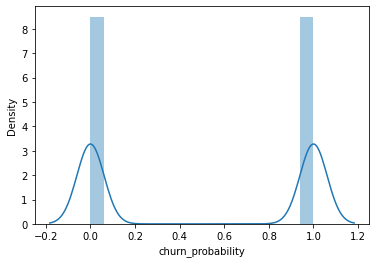

In [161]:
import seaborn as sns 
import matplotlib.pyplot as plt
sns.distplot(y_res)
plt.show()

class is balanced now and the target variable not skwed

In [162]:
# train test split 
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(X_res,y_res,train_size=0.7,test_size=0.3,random_state=100)

In [163]:
print(x_train.shape)
print(x_test.shape)
print(y_train.shape)
print(y_test.shape)

(26349, 124)
(11293, 124)
(26349,)
(11293,)


# Rescaling 

In [164]:
from sklearn.preprocessing import StandardScaler

# Instantiate 
scaler = StandardScaler()
# fit on train data
scaler.fit_transform(x_train)
# transform on test data
scaler.transform(x_test)

array([[-1.1873262 , -0.58321222, -0.40909249, ..., -0.32692691,
        -0.3535207 , -0.32952076],
       [ 0.05750307, -0.19617117, -0.85484495, ..., -0.32692691,
        -0.3535207 , -0.32952076],
       [ 0.00664665, -0.78714503,  0.50172148, ..., -0.31754844,
        -0.3535207 , -0.32952076],
       ...,
       [-0.9291526 , -0.60155002,  0.02855837, ...,  2.50560572,
         0.64151703,  0.50889303],
       [-0.35987254, -0.51003195, -0.75269199, ..., -0.32692691,
        -0.3535207 , -0.32952076],
       [-0.10039582, -0.07913708,  0.99871388, ..., -0.32692691,
        -0.3535207 , -0.32952076]])

In [165]:
x_train.head()

,arpu_6,arpu_7,arpu_8,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_mou_6,std_og_mou_7,std_og_mou_8,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,og_others_6,og_others_7,og_others_8,total_og_mou_6,total_og_mou_7,total_og_mou_8,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,ic_others_6,ic_others_7,ic_others_8,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,monthly_2g_6,monthly_2g_7,monthly_2g_8,sachet_2g_6,sachet_2g_7,sachet_2g_8,monthly_3g_6,monthly_3g_7,monthly_3g_8,sachet_3g_6,sachet_3g_7,sachet_3g_8,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g
10661,565.598000,588.81400,702.341000,326.080000,335.380000,411.39000,929.680000,1119.910000,928.310000,0.0,0.000000,0.00000,0.0,0.000000,0.000000,326.08000,335.380000,406.340000,910.240000,1102.060000,916.160000,14.08,8.41,4.18,0.00000,0.0,7.96,1250.410000,1445.860000,1326.690000,0.000000,0.000000,5.050000,5.340000,9.430000,0.000000,0.00,0.0,0.0,5.340000,9.430000,5.05000,0.00,0.0,0.0,0.000000,0.00,7.96,0.00,0.0,0.0,1255.760000,1455.290000,1339.710000,232.240000,287.19000,246.510000,815.510000,883.210000,834.71000,411.34,465.710000,317.86,1459.110000,1636.13000,1399.090000,0.00000,2.900000,9.60,0.390000,60.810000,0.23,0.00,0.00,0.00,0.390000,63.710000,9.83,1459.510000,1700.780000,1408.930000,0.0,0.0,0.0,0.000000,0.930000,0.0,0.000000,0.000000,0.0,9,8,6,775,920,637,269,339,339,0,339,0,0.00,0.00,0.0,0.0,0.00,0.0,0,0,0,0,0,0,0,0,0,0,0,0,1661,0.00,0.00,0.00
11679,175.568000,84.63000,234.652000,37.190000,47.810000,89.03000,86.840000,70.780000,140.180000,0.0,0.000000,98.13000,0.0,0.000000,37.110000,31.23000,41.230000,55.860000,63.240000,56.610000,81.230000,0.00,1.44,3.39,0.20000,0.0,0.00,94.480000,99.290000,140.490000,5.960000,6.580000,21.590000,17.760000,8.310000,27.990000,5.63,4.4,2.0,29.360000,19.290000,51.59000,0.00,0.0,0.0,0.200000,0.00,0.00,0.00,0.0,0.0,124.040000,118.590000,192.090000,46.130000,58.28000,54.410000,44.710000,27.630000,49.73000,0.00,2.990000,0.05,90.840000,88.91000,104.190000,12.66000,15.640000,11.33,22.660000,13.490000,14.58,5.71,10.35,2.73,41.040000,39.490000,28.64,131.890000,128.410000,132.840000,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.000000,0.0,5,0,5,1024,0,93,750,0,67,750,0,67,424.99,0.00,0.0,0.0,0.00,0.0,1,0,0,0,0,0,0,0,0,0,0,0,2445,0.00,0.00,0.00
19155,130.174000,287.74300,25.460000,7.260000,13.700000,0.45000,3.890000,22.990000,18.260000,0.0,0.000000,0.00000,0.0,0.000000,0.000000,7.26000,13.700000,0.450000,3.890000,22.990000,18.260000,0.00,0.00,0.00,0.00000,0.0,0.00,11.160000,36.690000,18.710000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00,0.0,0.0,0.000000,0.000000,0.00000,0.00,0.0,0.0,0.000000,0.00,0.00,0.00,0.0,0.0,11.160000,36.690000,18.710000,1.960000,0.00000,1.410000,5.790000,6.190000,8.66000,1.28,0.000000,0.00,9.040000,6.19000,10.080

In [166]:
x_train.shape

(26349, 124)

In [167]:
col =[]

for col in x_train.columns:
    print(col)

arpu_6
arpu_7
arpu_8
onnet_mou_6
onnet_mou_7
onnet_mou_8
offnet_mou_6
offnet_mou_7
offnet_mou_8
roam_ic_mou_6
roam_ic_mou_7
roam_ic_mou_8
roam_og_mou_6
roam_og_mou_7
roam_og_mou_8
loc_og_t2t_mou_6
loc_og_t2t_mou_7
loc_og_t2t_mou_8
loc_og_t2m_mou_6
loc_og_t2m_mou_7
loc_og_t2m_mou_8
loc_og_t2f_mou_6
loc_og_t2f_mou_7
loc_og_t2f_mou_8
loc_og_t2c_mou_6
loc_og_t2c_mou_7
loc_og_t2c_mou_8
loc_og_mou_6
loc_og_mou_7
loc_og_mou_8
std_og_t2t_mou_6
std_og_t2t_mou_7
std_og_t2t_mou_8
std_og_t2m_mou_6
std_og_t2m_mou_7
std_og_t2m_mou_8
std_og_t2f_mou_6
std_og_t2f_mou_7
std_og_t2f_mou_8
std_og_mou_6
std_og_mou_7
std_og_mou_8
isd_og_mou_6
isd_og_mou_7
isd_og_mou_8
spl_og_mou_6
spl_og_mou_7
spl_og_mou_8
og_others_6
og_others_7
og_others_8
total_og_mou_6
total_og_mou_7
total_og_mou_8
loc_ic_t2t_mou_6
loc_ic_t2t_mou_7
loc_ic_t2t_mou_8
loc_ic_t2m_mou_6
loc_ic_t2m_mou_7
loc_ic_t2m_mou_8
loc_ic_t2f_mou_6
loc_ic_t2f_mou_7
loc_ic_t2f_mou_8
loc_ic_mou_6
loc_ic_mou_7
loc_ic_mou_8
std_ic_t2t_mou_6
std_ic_t2t_mou_7


In [168]:
col = x_train.columns.values

In [169]:
col

array(['arpu_6', 'arpu_7', 'arpu_8', 'onnet_mou_6', 'onnet_mou_7',
       'onnet_mou_8', 'offnet_mou_6', 'offnet_mou_7', 'offnet_mou_8',
       'roam_ic_mou_6', 'roam_ic_mou_7', 'roam_ic_mou_8', 'roam_og_mou_6',
       'roam_og_mou_7', 'roam_og_mou_8', 'loc_og_t2t_mou_6',
       'loc_og_t2t_mou_7', 'loc_og_t2t_mou_8', 'loc_og_t2m_mou_6',
       'loc_og_t2m_mou_7', 'loc_og_t2m_mou_8', 'loc_og_t2f_mou_6',
       'loc_og_t2f_mou_7', 'loc_og_t2f_mou_8', 'loc_og_t2c_mou_6',
       'loc_og_t2c_mou_7', 'loc_og_t2c_mou_8', 'loc_og_mou_6',
       'loc_og_mou_7', 'loc_og_mou_8', 'std_og_t2t_mou_6',
       'std_og_t2t_mou_7', 'std_og_t2t_mou_8', 'std_og_t2m_mou_6',
       'std_og_t2m_mou_7', 'std_og_t2m_mou_8', 'std_og_t2f_mou_6',
       'std_og_t2f_mou_7', 'std_og_t2f_mou_8', 'std_og_mou_6',
       'std_og_mou_7', 'std_og_mou_8', 'isd_og_mou_6', 'isd_og_mou_7',
       'isd_og_mou_8', 'spl_og_mou_6', 'spl_og_mou_7', 'spl_og_mou_8',
       'og_others_6', 'og_others_7', 'og_others_8', 'total_og_mou

# PCA

In [170]:
from sklearn.decomposition import PCA
#instantiate
pca = PCA(random_state=42)
# fit
pca.fit(x_train)

PCA(random_state=42)

In [171]:
pca.components_

array([[ 1.28937738e-01,  1.45243065e-01,  1.06475924e-01, ...,
        -3.10319872e-02, -3.84907608e-02, -3.83912673e-02],
       [ 1.23491304e-01,  1.79238309e-01,  2.19536799e-01, ...,
         1.44853782e-01,  1.64096700e-01,  1.57552446e-01],
       [ 7.33098596e-02,  1.10905474e-01,  1.67066233e-01, ...,
        -5.71799875e-02, -7.55333850e-02, -7.98920889e-02],
       ...,
       [-2.91950603e-08,  2.17825678e-07, -5.70653511e-08, ...,
        -1.00475642e-07,  8.49762564e-08, -6.24420628e-09],
       [ 2.93772171e-07,  1.98756596e-07, -6.65738287e-08, ...,
         4.60703020e-08, -9.59194146e-08,  6.69867620e-08],
       [ 2.00110683e-07,  2.87580782e-07,  7.53493257e-08, ...,
         1.60606079e-07, -9.18653764e-08,  9.28664920e-08]])

In [172]:
pca.explained_variance_ratio_

array([2.99169301e-01, 1.44608139e-01, 9.97714970e-02, 8.59076223e-02,
       6.31597077e-02, 5.74761047e-02, 4.33908870e-02, 3.00971247e-02,
       2.14023081e-02, 1.91632162e-02, 1.46771455e-02, 1.42812472e-02,
       1.29573430e-02, 1.13588511e-02, 8.43452308e-03, 7.49755326e-03,
       6.49453702e-03, 5.52110612e-03, 5.41218316e-03, 5.00797544e-03,
       4.64130666e-03, 3.80621733e-03, 3.21035580e-03, 2.96512983e-03,
       2.68787191e-03, 2.59959986e-03, 2.50519023e-03, 2.17801513e-03,
       1.80273105e-03, 1.74797518e-03, 1.67820145e-03, 1.31122967e-03,
       1.18056356e-03, 9.70997765e-04, 9.32150959e-04, 8.83765370e-04,
       8.33893033e-04, 7.42584529e-04, 6.98358020e-04, 6.39547458e-04,
       6.14200146e-04, 5.38844057e-04, 5.22506413e-04, 4.82562581e-04,
       4.42861203e-04, 4.28287776e-04, 4.18525303e-04, 3.55826541e-04,
       3.06099688e-04, 2.89985691e-04, 2.34334882e-04, 2.18548424e-04,
       1.90713701e-04, 1.75381525e-04, 1.61690965e-04, 1.17562141e-04,
      

In [173]:
# Converting to data frame for ease of interpretation
vardat = pd.DataFrame(pca.explained_variance_ratio_)
vardat

,0
0,2.991693e-01
1,1.446081e-01
2,9.977150e-02
3,8.590762e-02
4,6.315971e-02
5,5.747610e-02
6,4.339089e-02
7,3.009712e-02
8,2.140231e-02
9,1.916322e-02


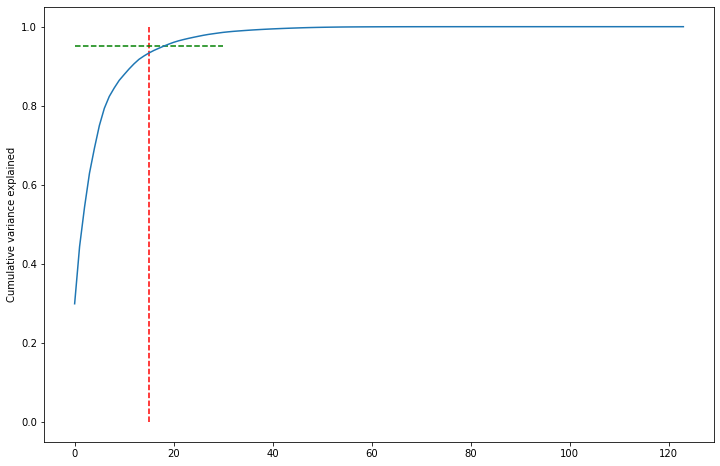

In [174]:
# Making a scree plot
var_cumu = np.cumsum(pca.explained_variance_ratio_)
fig = plt.figure(figsize=[12,8])
plt.vlines(x=15, ymax=1, ymin=0, colors="r", linestyles="--")
plt.hlines(y=0.95, xmax=30, xmin=0, colors="g", linestyles="--")
plt.plot(var_cumu)
plt.ylabel("Cumulative variance explained")
plt.show()

In [175]:
# performing  PCA with 16 components
from sklearn.decomposition import IncrementalPCA
pca_final = PCA(n_components=16,random_state=42)
df_train_pca = pca_final.fit_transform(x_train)

In [176]:
df_train_pca.shape

(26349, 16)

In [177]:
# Applying Transformation on test data 
df_test_pca = pca_final.transform(x_test)
df_test_pca.shape

(11293, 16)

# Assesing the model with Stats model on PCA data

In [178]:
import statsmodels.api as sm
# Logestic regression Model
log_P = sm.GLM(y_train,(sm.add_constant(df_train_pca)),family = sm.families.Binomial())
logm_PCA=log_P.fit()
logm_PCA.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:      churn_probability   No. Observations:                26349
Model:                            GLM   Df Residuals:                    26332
Model Family:                Binomial   Df Model:                           16
Link Function:                  logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -12963.
Date:                Wed, 15 Jun 2022   Deviance:                       25926.
Time:                        19:49:17   Pearson chi2:                 2.59e+05
No. Iterations:                     6                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         -0.0821      0.017     -4.956      0.000      -0.115      -0.050
x1             0.0002   9.27e-06     23.464      0.000       0.000       0.000
x2            -0.0009   1.95e-05    -45.940      0.000      -0.001      -0.001
x3            -0.0006    1.9e-05    -31.155      0.000      -0.001      -0.001
x4             0.0005   1.89e-05     27.809      0.000       0.000       0.001
x5            -0.0005   2.14e-05    -24.555      0.000      -0.001      -0.000
x6             0.0007   2.29e-05     29.808      0.000       0.001       0.001
x7             0.0008   2.73e-05     28.123      0.000       0.001       0.001
x8            -0.0010   3.39e-05    -30.571      0.000      -0.001      -0.001
x9            -0.0005    4.3e-05    -10.504      0.000      -0.001      -0.000
x10           -0.0010   4.56e-05    -21.022      0.000      -0.001      -0.001
x11           -0.0007   4.45e-05    -16.240      0.000      -0.001      -0.001
x12            0.0008   5.16e-05     14.675      0.000       0.001       0.001
x13            0.0003   5.08e-05      6.520      0.000       0.000       0.000
x14         6.265e-05   5.71e-05      1.098      0.272   -4.92e-05       0.000
x15            0.0001   6.18e-05      2.126      0.034    1.03e-05       0.000
x16           -0.0015   7.06e-05    -20.908      0.000      -0.002      -0.001
==============================================================================
"""

In [179]:
# Getting the predicted value on  train set 
y_train_pred = logm_PCA.predict(sm.add_constant(df_train_pca))
y_train_pred

array([0.0038261 , 0.57079004, 0.44489934, ..., 0.22433315, 0.14751729,
       0.04443924])

In [180]:
# Ctreating a data frame with the actual churn flag and the predicted probabilties
y_train_pred_Final = pd.DataFrame({'churn_probability':y_train.values,'Churn_Pred_Prob':y_train_pred})
y_train_pred_Final.head()

,churn_probability,Churn_Pred_Prob
0,0,0.003826
1,0,0.570790
2,0,0.444899
3,1,0.906640
4,0,0.063492


In [181]:
y_train_pred_Final['id']= y_train.index

In [182]:
y_train_pred_Final.head()

,churn_probability,Churn_Pred_Prob,id
0,0,0.003826,10661
1,0,0.570790,11679
2,0,0.444899,19155
3,1,0.906640,29423
4,0,0.063492,10526


## Creating new column ' Predicted ' with 1 if churn prob > 0.5 else 0

In [183]:
y_train_pred_Final['Predicted']= y_train_pred_Final.Churn_Pred_Prob.map(lambda x: 1 if x>0.5 else 0)
y_train_pred_Final.head()

,churn_probability,Churn_Pred_Prob,id,Predicted
0,0,0.003826,10661,0
1,0,0.570790,11679,1
2,0,0.444899,19155,0
3,1,0.906640,29423,1
4,0,0.063492,10526,0


In [184]:
# Confusion Matrix
confusion = metrics.confusion_matrix(y_train_pred_Final.churn_probability, y_train_pred_Final.Predicted)
confusion

array([[10139,  2999],
       [ 2603, 10608]], dtype=int64)

In [185]:
# Lets Check Overall Accuracy 
# Calculate accuracy
print(metrics.accuracy_score(y_train_pred_Final.churn_probability, y_train_pred_Final.Predicted))

0.7873923109036396


In [186]:
# Metrics beyond Accuracy 

TP = confusion[1,1] # true positive 
TN = confusion[0,0] # true negatives
FP = confusion[0,1] # false positives
FN = confusion[1,0] # false negatives

In [187]:
# Sensitivity 
TP/float(TP+FN)

0.8029672242827947

In [188]:
# Specificity
TN/float(TN+FP)

0.7717308570558685

## Plot ROC curve

In [189]:
# Defining the function to plot the ROC curve
def draw_roc( actual, probs ):
    fpr, tpr, thresholds = metrics.roc_curve( actual, probs,
                                              drop_intermediate = False )
    auc_score = metrics.roc_auc_score( actual, probs )
    plt.figure(figsize=(5, 5))
    plt.plot( fpr, tpr, label='ROC curve (area = %0.2f)' % auc_score )
    plt.plot([0, 1], [0, 1], 'k--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate or [1 - True Negative Rate]')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver operating characteristic example')
    plt.legend(loc="lower right")
    plt.show()

    return None

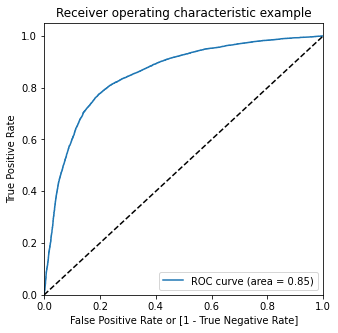

In [190]:
# Calling the function
draw_roc(y_train_pred_Final.churn_probability, y_train_pred_Final.Churn_Pred_Prob)

In [191]:
# lets Create column with different cutt offs.
numbers = [float(x)/10 for x in range(10)]
for i in numbers:
    y_train_pred_Final[i]= y_train_pred_Final.Churn_Pred_Prob.map(lambda x: 1 if x>i else 0)

y_train_pred_Final.head()

,churn_probability,Churn_Pred_Prob,id,Predicted,0.0,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9
0,0,0.003826,10661,0,1,0,0,0,0,0,0,0,0,0
1,0,0.570790,11679,1,1,1,1,1,1,1,0,0,0,0
2,0,0.444899,19155,0,1,1,1,1,1,0,0,0,0,0
3,1,0.906640,29423,1,1,1,1,1,1,1,1,1,1,1
4,0,0.063492,10526,0,1,0,0,0,0,0,0,0,0,0


## Calculate Accuracy, Sensitivity and Specificity

In [192]:
# Now let's calculate accuracy sensitivity and specificity for various probability cutoffs.
cutoff_df = pd.DataFrame( columns = ['prob','accuracy','sensi','speci'])
from sklearn.metrics import confusion_matrix

# TP = confusion[1,1] # true positive 
# TN = confusion[0,0] # true negatives
# FP = confusion[0,1] # false positives
# FN = confusion[1,0] # false negatives

num = [0.0,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9]
for i in num:
    cm1 = metrics.confusion_matrix(y_train_pred_Final.churn_probability, y_train_pred_Final[i] )
    total1=sum(sum(cm1))
    accuracy = (cm1[0,0]+cm1[1,1])/total1
    
    speci = cm1[0,0]/(cm1[0,0]+cm1[0,1])
    sensi = cm1[1,1]/(cm1[1,0]+cm1[1,1])
    cutoff_df.loc[i] =[ i ,accuracy,sensi,speci]
print(cutoff_df)

     prob  accuracy     sensi     speci
0.0   0.0  0.501385  1.000000  0.000000
0.1   0.1  0.601579  0.981758  0.219288
0.2   0.2  0.666515  0.956021  0.375400
0.3   0.3  0.721697  0.921883  0.520399
0.4   0.4  0.760219  0.865945  0.653905
0.5   0.5  0.787392  0.802967  0.771731
0.6   0.6  0.778246  0.694346  0.862612
0.7   0.7  0.730995  0.544092  0.918937
0.8   0.8  0.665149  0.373779  0.958137
0.9   0.9  0.572470  0.164333  0.982874


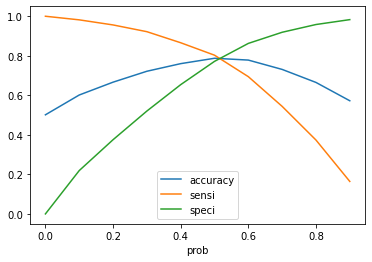

In [193]:
# plotting Accuracy , Sensitivity, Specifcity for different probabilities
cutoff_df.plot.line(x='prob',y= ['accuracy','sensi','speci'])
plt.show()

### As from the above curve we getting optimum threshould which is 0.5 which we have already used. still lets create new final column with final prediction

In [194]:
# Creating new column 'predicted' with 1 if Churn_Prob > 0.5 else 0
y_train_pred_Final['Final_prediction'] = y_train_pred_Final.Churn_Pred_Prob.map(lambda x: 1 if x > 0.5 else 0)
y_train_pred_Final.head()

,churn_probability,Churn_Pred_Prob,id,Predicted,0.0,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,Final_prediction
0,0,0.003826,10661,0,1,0,0,0,0,0,0,0,0,0,0
1,0,0.570790,11679,1,1,1,1,1,1,1,0,0,0,0,1
2,0,0.444899,19155,0,1,1,1,1,1,0,0,0,0,0,0
3,1,0.906640,29423,1,1,1,1,1,1,1,1,1,1,1,1
4,0,0.063492,10526,0,1,0,0,0,0,0,0,0,0,0,0


#### Making prediction on test set 

In [195]:
X_test_sm = sm.add_constant(df_test_pca)

In [196]:
# Making Prediction on test data set 
y_test_pred = logm_PCA.predict(X_test_sm)

In [197]:
# Ctreating a data frame with the actual churn flag and the predicted probabilties
y_test_pred_Final = pd.DataFrame({'churn_probability':y_test.values,'Churn_Pred_Prob':y_test_pred})
y_test_pred_Final.head()

,churn_probability,Churn_Pred_Prob
0,1,0.343796
1,1,0.929269
2,1,0.714876
3,1,0.494137
4,1,0.374203


In [198]:
y_test_pred_Final['id']= y_test.index
y_test_pred_Final.head()

,churn_probability,Churn_Pred_Prob,id
0,1,0.343796,2221
1,1,0.929269,21109
2,1,0.714876,22947
3,1,0.494137,20726
4,1,0.374203,28701


In [199]:
y_test_pred_Final['Predicted']= y_test_pred_Final.Churn_Pred_Prob.map(lambda x: 1 if x>0.5 else 0)
y_test_pred_Final.head()

,churn_probability,Churn_Pred_Prob,id,Predicted
0,1,0.343796,2221,0
1,1,0.929269,21109,1
2,1,0.714876,22947,1
3,1,0.494137,20726,0
4,1,0.374203,28701,0


In [200]:
# Confusion Matrix
confusion = metrics.confusion_matrix(y_test_pred_Final.churn_probability, y_test_pred_Final.Predicted)
confusion

array([[4398, 1285],
       [1027, 4583]], dtype=int64)

In [201]:
# Lets Check Overall Accuracy 
# Calculate accuracy
print(metrics.accuracy_score(y_test_pred_Final.churn_probability, y_test_pred_Final.Predicted))

0.7952714070663243


# Prediction on unseen data (Test)

In [202]:
unseen.head()

,id,circle_id,loc_og_t2o_mou,std_og_t2o_mou,loc_ic_t2o_mou,last_date_of_month_6,last_date_of_month_7,last_date_of_month_8,arpu_6,arpu_7,arpu_8,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_t2c_mou_6,std_og_t2c_mou_7,std_og_t2c_mou_8,std_og_mou_6,std_og_mou_7,std_og_mou_8,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,og_others_6,og_others_7,og_others_8,total_og_mou_6,total_og_mou_7,total_og_mou_8,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_t2o_mou_6,std_ic_t2o_mou_7,std_ic_t2o_mou_8,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,ic_others_6,ic_others_7,ic_others_8,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,date_of_last_rech_6,date_of_last_rech_7,date_of_last_rech_8,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,date_of_last_rech_data_6,date_of_last_rech_data_7,date_of_last_rech_data_8,total_rech_data_6,total_rech_data_7,total_rech_data_8,max_rech_data_6,max_rech_data_7,max_rech_data_8,count_rech_2g_6,count_rech_2g_7,count_rech_2g_8,count_rech_3g_6,count_rech_3g_7,count_rech_3g_8,av_rech_amt_data_6,av_rech_amt_data_7,av_rech_amt_data_8,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,arpu_3g_6,arpu_3g_7,arpu_3g_8,arpu_2g_6,arpu_2g_7,arpu_2g_8,night_pck_user_6,night_pck_user_7,night_pck_user_8,monthly_2g_6,monthly_2g_7,monthly_2g_8,sachet_2g_6,sachet_2g_7,sachet_2g_8,monthly_3g_6,monthly_3g_7,monthly_3g_8,sachet_3g_6,sachet_3g_7,sachet_3g_8,fb_user_6,fb_user_7,fb_user_8,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g
0,69999,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,91.882,65.330,64.445,31.78,20.23,23.11,60.16,32.16,34.83,0.00,0.00,0.00,0.00,0.00,0.00,24.88,20.23,21.06,18.13,10.89,8.36,0.00,13.58,0.00,0.0,0.00,0.03,43.01,44.71,29.43,6.90,0.00,2.05,42.03,7.68,26.43,0.0,0.0,0.0,0.0,0.0,0.0,48.93,7.68,28.48,0.0,0.0,0.0,0.00,0.00,0.03,0.0,0.0,0.0,91.94,52.39,57.94,30.33,37.56,21.98,10.21,4.59,9.53,0.26,0.00,0.00,40.81,42.16,31.51,0.00,0.00,0.00,0.36,1.04,4.34,0.0,0.0,0.00,0.0,0.0,0.0,0.36,1.04,4.34,41.73,43.56,36.26,0.54,0.34,0.39,0.00,0.00,0.00,0.0,0.0,0.00,5,5,4,103,90,60,50,30,30,6/21/2014,7/26/2014,8/24/2014,30,30,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,1692,0.00,0.00,0.00
1,70000,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,414.168,515.568,360.868,75.51,41.21,19.84,474.34,621.84,394.94,0.00,0.00,0.00,0.00,0.00,0.00,75.51,41.21,19.84,473.61,598.08,377.26,0.73,0.00,0.00,0.0,0.00,0.00,549.86,639.29,397.11,0.00,0.00,0.00,0.00,23.76,17.68,0.0,0.0,0.0,0.0,0.0,0.0,0.00,23.76,17.68,0.0,0.0,0.8,0.00,0.00,0.00,0.0,0.0,0.0,549.86,663.06,415.59,19.99,26.95,2.61,160.19,122.29,184.81,1.49,0.00,0.00,181.69,149.24,187.43,0.00,0.00,0.00,0.00,12.51,0.00,0.0,0.0,0.00,0.0,0.0,0.0,0.00,12.51,0.00,296.33,339.64,281.66,0.00,0.00,0.00,114.63,177.88,94.23,0.0,0.0,0.00,5,4,5,500,500,500,250,250,250,6/19/2014,7/16/2014,8/24/2014,250,0,0,NaN,NaN,Na

In [203]:
unseen.shape

(30000, 171)

In [204]:
High_val_cust_unseen= unseen

In [205]:
# Checking object data type columns 
object_columns_data = High_val_cust_unseen.select_dtypes(include=['object'])
print(object_columns_data.iloc[0])

last_date_of_month_6        6/30/2014
last_date_of_month_7        7/31/2014
last_date_of_month_8        8/31/2014
date_of_last_rech_6         6/21/2014
date_of_last_rech_7         7/26/2014
date_of_last_rech_8         8/24/2014
date_of_last_rech_data_6          NaN
date_of_last_rech_data_7          NaN
date_of_last_rech_data_8          NaN
Name: 0, dtype: object


In [206]:
High_val_cust_unseen=High_val_cust_unseen.drop(object_columns_data,axis=1)
High_val_cust_unseen.head()

,id,circle_id,loc_og_t2o_mou,std_og_t2o_mou,loc_ic_t2o_mou,arpu_6,arpu_7,arpu_8,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_t2c_mou_6,std_og_t2c_mou_7,std_og_t2c_mou_8,std_og_mou_6,std_og_mou_7,std_og_mou_8,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,og_others_6,og_others_7,og_others_8,total_og_mou_6,total_og_mou_7,total_og_mou_8,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_t2o_mou_6,std_ic_t2o_mou_7,std_ic_t2o_mou_8,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,ic_others_6,ic_others_7,ic_others_8,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,total_rech_data_6,total_rech_data_7,total_rech_data_8,max_rech_data_6,max_rech_data_7,max_rech_data_8,count_rech_2g_6,count_rech_2g_7,count_rech_2g_8,count_rech_3g_6,count_rech_3g_7,count_rech_3g_8,av_rech_amt_data_6,av_rech_amt_data_7,av_rech_amt_data_8,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,arpu_3g_6,arpu_3g_7,arpu_3g_8,arpu_2g_6,arpu_2g_7,arpu_2g_8,night_pck_user_6,night_pck_user_7,night_pck_user_8,monthly_2g_6,monthly_2g_7,monthly_2g_8,sachet_2g_6,sachet_2g_7,sachet_2g_8,monthly_3g_6,monthly_3g_7,monthly_3g_8,sachet_3g_6,sachet_3g_7,sachet_3g_8,fb_user_6,fb_user_7,fb_user_8,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g
0,69999,109,0.0,0.0,0.0,91.882,65.330,64.445,31.78,20.23,23.11,60.16,32.16,34.83,0.00,0.00,0.00,0.00,0.00,0.00,24.88,20.23,21.06,18.13,10.89,8.36,0.00,13.58,0.00,0.0,0.00,0.03,43.01,44.71,29.43,6.90,0.00,2.05,42.03,7.68,26.43,0.0,0.0,0.0,0.0,0.0,0.0,48.93,7.68,28.48,0.0,0.0,0.0,0.00,0.00,0.03,0.0,0.0,0.0,91.94,52.39,57.94,30.33,37.56,21.98,10.21,4.59,9.53,0.26,0.00,0.00,40.81,42.16,31.51,0.00,0.00,0.00,0.36,1.04,4.34,0.0,0.0,0.00,0.0,0.0,0.0,0.36,1.04,4.34,41.73,43.56,36.26,0.54,0.34,0.39,0.00,0.00,0.00,0.0,0.0,0.00,5,5,4,103,90,60,50,30,30,30,30,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,1692,0.00,0.00,0.00
1,70000,109,0.0,0.0,0.0,414.168,515.568,360.868,75.51,41.21,19.84,474.34,621.84,394.94,0.00,0.00,0.00,0.00,0.00,0.00,75.51,41.21,19.84,473.61,598.08,377.26,0.73,0.00,0.00,0.0,0.00,0.00,549.86,639.29,397.11,0.00,0.00,0.00,0.00,23.76,17.68,0.0,0.0,0.0,0.0,0.0,0.0,0.00,23.76,17.68,0.0,0.0,0.8,0.00,0.00,0.00,0.0,0.0,0.0,549.86,663.06,415.59,19.99,26.95,2.61,160.19,122.29,184.81,1.49,0.00,0.00,181.69,149.24,187.43,0.00,0.00,0.00,0.00,12.51,0.00,0.0,0.0,0.00,0.0,0.0,0.0,0.00,12.51,0.00,296.33,339.64,281.66,0.00,0.00,0.00,114.63,177.88,94.23,0.0,0.0,0.00,5,4,5,500,500,500,250,250,250,250,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,2533,0.00,0.00,0.00
2,70001,109,0.0,0.0,0.0,329.844,434.884,746.239,7.54,7.86,8.40,16.98,45.81,45.04,22.81,103.38,26.08,24.53,53.68,54.44,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0

In [207]:
# check the sahpe again
High_val_cust_unseen.shape

(30000, 162)

In [208]:
High_val_cust_unseen_W_id = High_val_cust_unseen.drop('id',axis=1)
High_val_cust_unseen_W_id.head()

,circle_id,loc_og_t2o_mou,std_og_t2o_mou,loc_ic_t2o_mou,arpu_6,arpu_7,arpu_8,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_t2c_mou_6,std_og_t2c_mou_7,std_og_t2c_mou_8,std_og_mou_6,std_og_mou_7,std_og_mou_8,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,og_others_6,og_others_7,og_others_8,total_og_mou_6,total_og_mou_7,total_og_mou_8,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_t2o_mou_6,std_ic_t2o_mou_7,std_ic_t2o_mou_8,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,ic_others_6,ic_others_7,ic_others_8,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,total_rech_data_6,total_rech_data_7,total_rech_data_8,max_rech_data_6,max_rech_data_7,max_rech_data_8,count_rech_2g_6,count_rech_2g_7,count_rech_2g_8,count_rech_3g_6,count_rech_3g_7,count_rech_3g_8,av_rech_amt_data_6,av_rech_amt_data_7,av_rech_amt_data_8,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,arpu_3g_6,arpu_3g_7,arpu_3g_8,arpu_2g_6,arpu_2g_7,arpu_2g_8,night_pck_user_6,night_pck_user_7,night_pck_user_8,monthly_2g_6,monthly_2g_7,monthly_2g_8,sachet_2g_6,sachet_2g_7,sachet_2g_8,monthly_3g_6,monthly_3g_7,monthly_3g_8,sachet_3g_6,sachet_3g_7,sachet_3g_8,fb_user_6,fb_user_7,fb_user_8,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g
0,109,0.0,0.0,0.0,91.882,65.330,64.445,31.78,20.23,23.11,60.16,32.16,34.83,0.00,0.00,0.00,0.00,0.00,0.00,24.88,20.23,21.06,18.13,10.89,8.36,0.00,13.58,0.00,0.0,0.00,0.03,43.01,44.71,29.43,6.90,0.00,2.05,42.03,7.68,26.43,0.0,0.0,0.0,0.0,0.0,0.0,48.93,7.68,28.48,0.0,0.0,0.0,0.00,0.00,0.03,0.0,0.0,0.0,91.94,52.39,57.94,30.33,37.56,21.98,10.21,4.59,9.53,0.26,0.00,0.00,40.81,42.16,31.51,0.00,0.00,0.00,0.36,1.04,4.34,0.0,0.0,0.00,0.0,0.0,0.0,0.36,1.04,4.34,41.73,43.56,36.26,0.54,0.34,0.39,0.00,0.00,0.00,0.0,0.0,0.00,5,5,4,103,90,60,50,30,30,30,30,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,1692,0.00,0.00,0.00
1,109,0.0,0.0,0.0,414.168,515.568,360.868,75.51,41.21,19.84,474.34,621.84,394.94,0.00,0.00,0.00,0.00,0.00,0.00,75.51,41.21,19.84,473.61,598.08,377.26,0.73,0.00,0.00,0.0,0.00,0.00,549.86,639.29,397.11,0.00,0.00,0.00,0.00,23.76,17.68,0.0,0.0,0.0,0.0,0.0,0.0,0.00,23.76,17.68,0.0,0.0,0.8,0.00,0.00,0.00,0.0,0.0,0.0,549.86,663.06,415.59,19.99,26.95,2.61,160.19,122.29,184.81,1.49,0.00,0.00,181.69,149.24,187.43,0.00,0.00,0.00,0.00,12.51,0.00,0.0,0.0,0.00,0.0,0.0,0.0,0.00,12.51,0.00,296.33,339.64,281.66,0.00,0.00,0.00,114.63,177.88,94.23,0.0,0.0,0.00,5,4,5,500,500,500,250,250,250,250,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,2533,0.00,0.00,0.00
2,109,0.0,0.0,0.0,329.844,434.884,746.239,7.54,7.86,8.40,16.98,45.81,45.04,22.81,103.38,26.08,24.53,53.68,54.44,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.00,0.00,0.00,0.0

In [209]:
High_val_cust_unseen_W_id = High_val_cust_unseen.drop('circle_id',axis=1)
High_val_cust_unseen_W_id.head()

,id,loc_og_t2o_mou,std_og_t2o_mou,loc_ic_t2o_mou,arpu_6,arpu_7,arpu_8,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2c_mou_6,loc_og_t2c_mou_7,loc_og_t2c_mou_8,loc_og_mou_6,loc_og_mou_7,loc_og_mou_8,std_og_t2t_mou_6,std_og_t2t_mou_7,std_og_t2t_mou_8,std_og_t2m_mou_6,std_og_t2m_mou_7,std_og_t2m_mou_8,std_og_t2f_mou_6,std_og_t2f_mou_7,std_og_t2f_mou_8,std_og_t2c_mou_6,std_og_t2c_mou_7,std_og_t2c_mou_8,std_og_mou_6,std_og_mou_7,std_og_mou_8,isd_og_mou_6,isd_og_mou_7,isd_og_mou_8,spl_og_mou_6,spl_og_mou_7,spl_og_mou_8,og_others_6,og_others_7,og_others_8,total_og_mou_6,total_og_mou_7,total_og_mou_8,loc_ic_t2t_mou_6,loc_ic_t2t_mou_7,loc_ic_t2t_mou_8,loc_ic_t2m_mou_6,loc_ic_t2m_mou_7,loc_ic_t2m_mou_8,loc_ic_t2f_mou_6,loc_ic_t2f_mou_7,loc_ic_t2f_mou_8,loc_ic_mou_6,loc_ic_mou_7,loc_ic_mou_8,std_ic_t2t_mou_6,std_ic_t2t_mou_7,std_ic_t2t_mou_8,std_ic_t2m_mou_6,std_ic_t2m_mou_7,std_ic_t2m_mou_8,std_ic_t2f_mou_6,std_ic_t2f_mou_7,std_ic_t2f_mou_8,std_ic_t2o_mou_6,std_ic_t2o_mou_7,std_ic_t2o_mou_8,std_ic_mou_6,std_ic_mou_7,std_ic_mou_8,total_ic_mou_6,total_ic_mou_7,total_ic_mou_8,spl_ic_mou_6,spl_ic_mou_7,spl_ic_mou_8,isd_ic_mou_6,isd_ic_mou_7,isd_ic_mou_8,ic_others_6,ic_others_7,ic_others_8,total_rech_num_6,total_rech_num_7,total_rech_num_8,total_rech_amt_6,total_rech_amt_7,total_rech_amt_8,max_rech_amt_6,max_rech_amt_7,max_rech_amt_8,last_day_rch_amt_6,last_day_rch_amt_7,last_day_rch_amt_8,total_rech_data_6,total_rech_data_7,total_rech_data_8,max_rech_data_6,max_rech_data_7,max_rech_data_8,count_rech_2g_6,count_rech_2g_7,count_rech_2g_8,count_rech_3g_6,count_rech_3g_7,count_rech_3g_8,av_rech_amt_data_6,av_rech_amt_data_7,av_rech_amt_data_8,vol_2g_mb_6,vol_2g_mb_7,vol_2g_mb_8,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,arpu_3g_6,arpu_3g_7,arpu_3g_8,arpu_2g_6,arpu_2g_7,arpu_2g_8,night_pck_user_6,night_pck_user_7,night_pck_user_8,monthly_2g_6,monthly_2g_7,monthly_2g_8,sachet_2g_6,sachet_2g_7,sachet_2g_8,monthly_3g_6,monthly_3g_7,monthly_3g_8,sachet_3g_6,sachet_3g_7,sachet_3g_8,fb_user_6,fb_user_7,fb_user_8,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g
0,69999,0.0,0.0,0.0,91.882,65.330,64.445,31.78,20.23,23.11,60.16,32.16,34.83,0.00,0.00,0.00,0.00,0.00,0.00,24.88,20.23,21.06,18.13,10.89,8.36,0.00,13.58,0.00,0.0,0.00,0.03,43.01,44.71,29.43,6.90,0.00,2.05,42.03,7.68,26.43,0.0,0.0,0.0,0.0,0.0,0.0,48.93,7.68,28.48,0.0,0.0,0.0,0.00,0.00,0.03,0.0,0.0,0.0,91.94,52.39,57.94,30.33,37.56,21.98,10.21,4.59,9.53,0.26,0.00,0.00,40.81,42.16,31.51,0.00,0.00,0.00,0.36,1.04,4.34,0.0,0.0,0.00,0.0,0.0,0.0,0.36,1.04,4.34,41.73,43.56,36.26,0.54,0.34,0.39,0.00,0.00,0.00,0.0,0.0,0.00,5,5,4,103,90,60,50,30,30,30,30,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,1692,0.00,0.00,0.00
1,70000,0.0,0.0,0.0,414.168,515.568,360.868,75.51,41.21,19.84,474.34,621.84,394.94,0.00,0.00,0.00,0.00,0.00,0.00,75.51,41.21,19.84,473.61,598.08,377.26,0.73,0.00,0.00,0.0,0.00,0.00,549.86,639.29,397.11,0.00,0.00,0.00,0.00,23.76,17.68,0.0,0.0,0.0,0.0,0.0,0.0,0.00,23.76,17.68,0.0,0.0,0.8,0.00,0.00,0.00,0.0,0.0,0.0,549.86,663.06,415.59,19.99,26.95,2.61,160.19,122.29,184.81,1.49,0.00,0.00,181.69,149.24,187.43,0.00,0.00,0.00,0.00,12.51,0.00,0.0,0.0,0.00,0.0,0.0,0.0,0.00,12.51,0.00,296.33,339.64,281.66,0.00,0.00,0.00,114.63,177.88,94.23,0.0,0.0,0.00,5,4,5,500,500,500,250,250,250,250,0,0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0,0,0,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,2533,0.00,0.00,0.00
2,70001,0.0,0.0,0.0,329.844,434.884,746.239,7.54,7.86,8.40,16.98,45.81,45.04,22.81,103.38,26.08,24.53,53.68,54.44,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.00,0.00,0.00,0.00

In [210]:
High_val_cust_unseen_W_id.shape

(30000, 161)

In [211]:
# imputing mising and NAN values with 0
High_val_cust_unseen_W_id =High_val_cust_unseen_W_id.fillna(0)

In [212]:
# Rescale unseen data
scaler.transform(High_val_cust_unseen_W_id[col])

array([[-1.10506425, -1.05381472, -0.72877925, ..., -0.32692691,
        -0.3535207 , -0.32952076],
       [-0.39047777, -0.12162851, -0.1201764 , ..., -0.32692691,
        -0.3535207 , -0.32952076],
       [-0.57744459, -0.28867908,  0.67105062, ...,  1.23505964,
         1.72373595,  0.34569983],
       ...,
       [-0.99954342, -1.10992337, -0.49112842, ..., -0.32692691,
        -0.3535207 , -0.32952076],
       [ 1.18098014,  0.42818035, -0.33253234, ..., -0.32692691,
        -0.3535207 , -0.32952076],
       [-0.60153273, -0.55161125,  0.38172184, ...,  1.93918835,
         1.5285027 , -0.26597453]])

In [213]:
# transform pca on unseen data
# Applying Transformation on test data(unseen data) 
df_test_unseen_pca = pca_final.transform(High_val_cust_unseen_W_id[col])
df_test_unseen_pca.shape

(30000, 16)

In [214]:
# Getting the predicted value on  unseen data 
y_unseen_pred = logm_PCA.predict(sm.add_constant(df_test_unseen_pca))
y_unseen_pred

array([0.51004223, 0.20940727, 0.41765838, ..., 0.52077535, 0.90419421,
       0.18322627])

In [215]:
High_val_cust_unseen['Pred_churn_probability']= y_unseen_pred

In [216]:
output = High_val_cust_unseen[['id','Pred_churn_probability']]
output.head()

,id,Pred_churn_probability
0,69999,0.510042
1,70000,0.209407
2,70001,0.417658
3,70002,0.327062
4,70003,0.488123


In [217]:
# now lets convert probability prediction into class 0 and 1 
# and add final column 'churn_probability' as per threshould obtain which is 0.5

output['churn_probability'] = output.Pred_churn_probability.map(lambda x: 1 if x>0.5 else 0)
output.head()

,id,Pred_churn_probability,churn_probability
0,69999,0.510042,1
1,70000,0.209407,0
2,70001,0.417658,0
3,70002,0.327062,0
4,70003,0.488123,0


In [218]:
# dropping 'Pred_churn_probability' as not required in submission file
submision = output.drop('Pred_churn_probability', axis=1)
submision.head()

,id,churn_probability
0,69999,1
1,70000,0
2,70001,0
3,70002,0
4,70003,0


In [219]:
# converting to csv file
submision.to_csv(r'C:\Users\pc\OneDrive\Desktop\Kaggle_project\submission_pca_lr_14jul.csv',index=False)

# For Drivers (Feature importance)


## Decision Tree

In [220]:
print(x_train.shape)
print(x_test.shape)
print(y_train.shape)
print(y_test.shape)

(26349, 124)
(11293, 124)
(26349,)
(11293,)


In [221]:
# Visualize the decision tree
import six
import sys
sys.modules['sklearn.externals.six'] = six
from IPython.display import Image
from sklearn.externals.six import StringIO
from sklearn.tree import export_graphviz
import graphviz
import pydotplus
from sklearn.tree import plot_tree
from sklearn.tree import DecisionTreeClassifier

In [222]:
# Decision tree without any hypermeters
# Instantiate
dt_default = DecisionTreeClassifier(random_state=42)
#fit
dt_default.fit(x_train,y_train)

DecisionTreeClassifier(random_state=42)

In [223]:
# Plot graph
dot_data = StringIO()  

export_graphviz(dt_default, out_file=dot_data, filled=True, rounded=True,
                feature_names=x_train.columns, 
                class_names=['Not Churn', "Churn"])

graph = pydotplus.graph_from_dot_data(dot_data.getvalue())
Image(graph.create_png())

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.499642 to fit



In [224]:
# Evaluating the Model performance on Test set
y_train_pred = dt_default.predict(x_train)
y_test_pred = dt_default.predict(x_test)

In [225]:
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score

In [226]:
# Prediction Train set
print(accuracy_score(y_train,y_train_pred))
confusion_matrix(y_train,y_train_pred)

1.0


array([[13138,     0],
       [    0, 13211]], dtype=int64)

### Hyperparameter Tuning Using gridsearchcv()

In [227]:
# Instantiate
DT = DecisionTreeClassifier(random_state=42)

In [228]:
from sklearn.model_selection import GridSearchCV

In [229]:
params = {'max_depth':[2,3,5,10,20],'min_samples_leaf':[5,10,20,50,100],'criterion':['ginni','entropy']}

In [230]:
grid_search=GridSearchCV(estimator = DT,cv=4,param_grid =params,n_jobs =-1,verbose=1,scoring='accuracy')

In [231]:
%%time
grid_search.fit(x_train,y_train)

Fitting 4 folds for each of 50 candidates, totalling 200 fits
Wall time: 2min 17s


GridSearchCV(cv=4, estimator=DecisionTreeClassifier(random_state=42), n_jobs=-1,
             param_grid={'criterion': ['ginni', 'entropy'],
                         'max_depth': [2, 3, 5, 10, 20],
                         'min_samples_leaf': [5, 10, 20, 50, 100]},
             scoring='accuracy', verbose=1)

In [232]:
grid_search.cv_results_

{'mean_fit_time': array([ 0.17166609,  0.17883998,  0.18952358,  0.19564545,  0.18240577,
         0.18301696,  0.19076395,  0.19523138,  0.19791645,  0.17876536,
         0.17702442,  0.17977482,  0.18676722,  0.17928779,  0.18503064,
         0.18926829,  0.19815099,  0.17851377,  0.16626394,  0.17342919,
         0.18778253,  0.18466485,  0.1760146 ,  0.18289256,  0.16990447,
         1.41217357,  1.39703   ,  1.5486722 ,  1.71744198,  1.8151561 ,
         2.03506887,  2.05191916,  2.03430301,  2.03904974,  2.07600087,
         4.03534359,  4.47323126,  3.46866441,  3.26249516,  3.82827467,
         6.75585562,  5.96743321,  7.25475293,  5.60789841,  5.44597751,
         8.2107029 ,  8.03028697,  7.67597538,  6.3075968 , 11.68860948]),
 'std_fit_time': array([0.01292054, 0.0106174 , 0.01779678, 0.01303278, 0.01531231,
        0.02131309, 0.01247717, 0.02208148, 0.01584777, 0.0075311 ,
        0.02244421, 0.01369549, 0.0195781 , 0.00423093, 0.00970816,
        0.00708428, 0.01274742,

In [233]:
cv_df= pd.DataFrame(grid_search.cv_results_)
cv_df.head()

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_criterion,param_max_depth,param_min_samples_leaf,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,mean_test_score,std_test_score,rank_test_score
0,0.171666,0.012921,0.0,0.0,ginni,2,5,"{'criterion': 'ginni', 'max_depth': 2, 'min_sa...",NaN,NaN,NaN,NaN,NaN,NaN,26
1,0.178840,0.010617,0.0,0.0,ginni,2,10,"{'criterion': 'ginni', 'max_depth': 2, 'min_sa...",NaN,NaN,NaN,NaN,NaN,NaN,28
2,0.189524,0.017797,0.0,0.0,ginni,2,20,"{'criterion': 'ginni', 'max_depth': 2, 'min_sa...",NaN,NaN,NaN,NaN,NaN,NaN,29
3,0.195645,0.013033,0.0,0.0,ginni,2,50,"{'criterion': 'ginni', 'max_depth': 2, 'min_sa...",NaN,NaN,NaN,NaN,NaN,NaN,30
4,0.182406,0.015312,0.0,0.0,ginni,2,100,"{'criterion': 'ginni', 'max_depth': 2, 'min_sa...",NaN,NaN,NaN,NaN,NaN,NaN,31


In [234]:
cv_df.shape

(50, 15)

In [235]:
cv_df.nlargest(5,'mean_test_score')

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_criterion,param_max_depth,param_min_samples_leaf,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,mean_test_score,std_test_score,rank_test_score
45,8.210703,0.309086,0.035754,0.010572,entropy,20,5,"{'criterion': 'entropy', 'max_depth': 20, 'min...",0.904220,0.900714,0.899195,0.901169,0.901324,0.001824,1
40,6.755856,0.179033,0.036002,0.012510,entropy,10,5,"{'criterion': 'entropy', 'max_depth': 10, 'min...",0.904372,0.896007,0.897070,0.900865,0.899579,0.003304,2
46,8.030287,0.274234,0.053005,0.019224,entropy,20,10,"{'criterion': 'entropy', 'max_depth': 20, 'min...",0.898452,0.893578,0.895855,0.897829,0.896429,0.001904,3
41,5.967433,0.087999,0.026010,0.002450,entropy,10,10,"{'criterion': 'entropy', 'max_depth': 10, 'min...",0.897845,0.894186,0.894337,0.896766,0.895783,0.001570,4
47,7.675975,0.246100,0.032752,0.007824,entropy,20,20,"{'criterion': 'entropy', 'max_depth': 20, 'min...",0.892380,0.889631,0.886898,0.894337,0.890812,0.002811,5


In [236]:
grid_search.best_score_

0.9013244185595277

In [237]:
grid_search.best_estimator_

DecisionTreeClassifier(criterion='entropy', max_depth=20, min_samples_leaf=5,
                       random_state=42)

In [238]:
DT_best = grid_search.best_estimator_

In [239]:
# Evaluating the Model performance on train and Test set
y_train_pred = DT_best.predict(x_train)
y_test_pred = DT_best.predict(x_test)


In [240]:
# Prediction Train set
print(accuracy_score(y_train,y_train_pred))
confusion_matrix(y_train,y_train_pred)

0.9773425936468177


array([[12854,   284],
       [  313, 12898]], dtype=int64)

In [241]:
# prediction on test Set
print(accuracy_score(y_test,y_test_pred))
confusion_matrix(y_test,y_test_pred)

0.9170282475870007


array([[5173,  510],
       [ 427, 5183]], dtype=int64)

In [242]:
#Feature importance bt Decision Tree

DT_best.feature_importances_

array([0.00302679, 0.01357536, 0.00327362, 0.00199999, 0.00220931,
       0.0012706 , 0.0030872 , 0.00244277, 0.00640993, 0.00127196,
       0.00759701, 0.01081659, 0.00359073, 0.00135223, 0.32365327,
       0.00320733, 0.00354671, 0.00598181, 0.00261235, 0.0048754 ,
       0.00133229, 0.00594092, 0.00231895, 0.00326689, 0.00236612,
       0.00284655, 0.00132832, 0.00289133, 0.00202991, 0.00380665,
       0.0032745 , 0.00484304, 0.00122204, 0.00419427, 0.00193881,
       0.00287181, 0.00246585, 0.00083571, 0.        , 0.00091516,
       0.00507461, 0.00402226, 0.00074389, 0.        , 0.00706066,
       0.01032664, 0.03136586, 0.00615682, 0.00404874, 0.        ,
       0.        , 0.00042931, 0.00334927, 0.00293524, 0.00543984,
       0.00240983, 0.00239736, 0.00359231, 0.00368186, 0.00313515,
       0.00437196, 0.00224854, 0.00534455, 0.00127641, 0.00266531,
       0.00376208, 0.00265684, 0.00691435, 0.00289659, 0.00237541,
       0.00301831, 0.00591599, 0.00471223, 0.00134298, 0.00344

In [243]:
# converting into dataframe
DF_RF = pd.DataFrame({'varname':x_train.columns,'imp':DT_best.feature_importances_})
DF_RF.sort_values(by= 'imp',ascending =False)

,varname,imp
14,roam_og_mou_8,0.323653
95,total_rech_amt_8,0.093038
101,last_day_rch_amt_8,0.054857
80,total_ic_mou_8,0.049755
46,spl_og_mou_7,0.031366
104,vol_2g_mb_8,0.017184
1,arpu_7,0.013575
100,last_day_rch_amt_7,0.011855
11,roam_ic_mou_8,0.010817
45,spl_og_mou_6,0.010327


In [244]:
# Plot graph
dot_data = StringIO()  

export_graphviz(DT_best, out_file=dot_data, filled=True, rounded=True,
                feature_names=x_train.columns, 
                class_names=['Not Churn', "Churn"])

graph = pydotplus.graph_from_dot_data(dot_data.getvalue())
Image(graph.create_png())

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.550345 to fit



# Random forest 

In [245]:
from sklearn.ensemble import RandomForestClassifier

In [246]:
# Instantiate 
RF = RandomForestClassifier(random_state=42)

In [247]:
params_F = {'max_depth':[2,3,5,10,20],'min_samples_leaf':[5,10,20,50,100],'criterion':['ginni','entropy']}

In [248]:
grid_search_F=GridSearchCV(estimator = RF,cv=4,param_grid =params_F,n_jobs =-1,verbose=1,scoring='accuracy')

In [249]:
%%time
grid_search_F.fit(x_train,y_train)

Fitting 4 folds for each of 50 candidates, totalling 200 fits
Wall time: 11min 2s


GridSearchCV(cv=4, estimator=RandomForestClassifier(random_state=42), n_jobs=-1,
             param_grid={'criterion': ['ginni', 'entropy'],
                         'max_depth': [2, 3, 5, 10, 20],
                         'min_samples_leaf': [5, 10, 20, 50, 100]},
             scoring='accuracy', verbose=1)

In [250]:
grid_search_F.cv_results_

{'mean_fit_time': array([ 0.38468492,  0.34584463,  0.48018157,  0.31807047,  0.32956541,
         0.29443574,  0.29599142,  0.31200945,  0.31787837,  0.28715426,
         0.33340192,  0.30181515,  0.30029553,  0.35778219,  0.28967553,
         0.29927194,  0.36405343,  0.41178602,  0.44722986,  0.36828005,
         0.35927969,  0.39242136,  0.32827812,  0.39460325,  0.39588767,
         8.99444014,  9.98622203,  8.68675494,  9.5341596 ,  9.42527187,
        13.32310426, 13.8448683 , 13.802212  , 13.53696007, 13.16306883,
        24.0745163 , 22.192774  , 22.24365401, 21.56741494, 20.22915769,
        39.27390283, 38.94250208, 36.24168479, 37.1831013 , 31.80270439,
        54.73875135, 39.50873911, 37.72758156, 32.46438962, 27.71300113]),
 'std_fit_time': array([0.01029908, 0.00846778, 0.02840655, 0.02009481, 0.02632097,
        0.01440442, 0.00748451, 0.01437476, 0.03532593, 0.02085164,
        0.00604576, 0.02184382, 0.01448167, 0.03104636, 0.01139006,
        0.00762914, 0.04008177,

In [251]:
cv_F_df= pd.DataFrame(grid_search.cv_results_)
cv_F_df.head()

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_criterion,param_max_depth,param_min_samples_leaf,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,mean_test_score,std_test_score,rank_test_score
0,0.171666,0.012921,0.0,0.0,ginni,2,5,"{'criterion': 'ginni', 'max_depth': 2, 'min_sa...",NaN,NaN,NaN,NaN,NaN,NaN,26
1,0.178840,0.010617,0.0,0.0,ginni,2,10,"{'criterion': 'ginni', 'max_depth': 2, 'min_sa...",NaN,NaN,NaN,NaN,NaN,NaN,28
2,0.189524,0.017797,0.0,0.0,ginni,2,20,"{'criterion': 'ginni', 'max_depth': 2, 'min_sa...",NaN,NaN,NaN,NaN,NaN,NaN,29
3,0.195645,0.013033,0.0,0.0,ginni,2,50,"{'criterion': 'ginni', 'max_depth': 2, 'min_sa...",NaN,NaN,NaN,NaN,NaN,NaN,30
4,0.182406,0.015312,0.0,0.0,ginni,2,100,"{'criterion': 'ginni', 'max_depth': 2, 'min_sa...",NaN,NaN,NaN,NaN,NaN,NaN,31


In [252]:
cv_F_df.nlargest(5,'mean_test_score')

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_criterion,param_max_depth,param_min_samples_leaf,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,mean_test_score,std_test_score,rank_test_score
45,8.210703,0.309086,0.035754,0.010572,entropy,20,5,"{'criterion': 'entropy', 'max_depth': 20, 'min...",0.904220,0.900714,0.899195,0.901169,0.901324,0.001824,1
40,6.755856,0.179033,0.036002,0.012510,entropy,10,5,"{'criterion': 'entropy', 'max_depth': 10, 'min...",0.904372,0.896007,0.897070,0.900865,0.899579,0.003304,2
46,8.030287,0.274234,0.053005,0.019224,entropy,20,10,"{'criterion': 'entropy', 'max_depth': 20, 'min...",0.898452,0.893578,0.895855,0.897829,0.896429,0.001904,3
41,5.967433,0.087999,0.026010,0.002450,entropy,10,10,"{'criterion': 'entropy', 'max_depth': 10, 'min...",0.897845,0.894186,0.894337,0.896766,0.895783,0.001570,4
47,7.675975,0.246100,0.032752,0.007824,entropy,20,20,"{'criterion': 'entropy', 'max_depth': 20, 'min...",0.892380,0.889631,0.886898,0.894337,0.890812,0.002811,5


In [253]:
grid_search_F.best_score_

0.9494098892051455

In [254]:
grid_search_F.best_estimator_

RandomForestClassifier(criterion='entropy', max_depth=20, min_samples_leaf=5,
                       random_state=42)

In [255]:
RF_best = grid_search_F.best_estimator_

In [256]:
# Evaluating the Model performance on train and Test set
y_train_pred_F = RF_best.predict(x_train)
y_test_pred_F = RF_best.predict(x_test)


In [257]:
# Prediction Train set
print(accuracy_score(y_train,y_train_pred_F))
confusion_matrix(y_train,y_train_pred_F)

0.9881968955178565


array([[12897,   241],
       [   70, 13141]], dtype=int64)

In [258]:
# prediction on test Set
print(accuracy_score(y_test,y_test_pred_F))
confusion_matrix(y_test,y_test_pred_F)

0.9565217391304348


array([[5374,  309],
       [ 182, 5428]], dtype=int64)

In [259]:
#Feature importance by Random forest

RF_best.feature_importances_

array([4.62247212e-03, 6.78783216e-03, 2.05805231e-02, 4.73581189e-03,
       5.03439787e-03, 5.13064728e-03, 4.74835698e-03, 4.50907026e-03,
       8.46330230e-03, 3.80546771e-03, 1.10466348e-02, 9.14729170e-02,
       5.23646356e-03, 1.93850644e-02, 9.76708968e-02, 4.53785861e-03,
       4.51001190e-03, 9.88778714e-03, 4.31313137e-03, 5.52188627e-03,
       1.54383924e-02, 3.06253139e-03, 3.70770934e-03, 4.48972502e-03,
       3.14882528e-03, 5.33528943e-03, 3.14988223e-03, 4.70813065e-03,
       5.79788299e-03, 1.90719573e-02, 9.51289881e-03, 8.47423925e-03,
       4.95488289e-03, 5.72953876e-03, 6.76635861e-03, 4.15600958e-03,
       1.12323619e-03, 1.39107368e-03, 7.48032492e-04, 6.09596244e-03,
       6.27648345e-03, 6.08529224e-03, 1.52562443e-03, 1.44037783e-03,
       1.44542424e-03, 9.35416988e-03, 1.36319357e-02, 5.68378913e-03,
       4.83677096e-03, 0.00000000e+00, 9.99673584e-05, 5.03932048e-03,
       5.17259731e-03, 8.84868083e-03, 4.51491500e-03, 5.93996136e-03,
      

In [260]:
DF_RF_Feature = pd.DataFrame({'varname':x_train.columns,'imp':RF_best.feature_importances_})
DF_RF_Feature.sort_values(by= 'imp',ascending =False)

,varname,imp
14,roam_og_mou_8,0.097671
11,roam_ic_mou_8,0.091473
80,total_ic_mou_8,0.034528
59,loc_ic_t2m_mou_8,0.033027
95,total_rech_amt_8,0.030808
65,loc_ic_mou_8,0.029959
101,last_day_rch_amt_8,0.028498
2,arpu_8,0.020581
13,roam_og_mou_7,0.019385
29,loc_og_mou_8,0.019072


In [261]:
# Predict Random Forest on unseen data
y_test_pred_unseen = RF_best.predict(High_val_cust_unseen_W_id[col])

In [262]:
High_val_cust_unseen['churn_probability']= y_test_pred_unseen

In [263]:
output = High_val_cust_unseen[['id','churn_probability']]
output.head()

,id,churn_probability
0,69999,0
1,70000,0
2,70001,1
3,70002,0
4,70003,0


In [264]:
output.shape

(30000, 2)

In [265]:
# converting to csv file
output.to_csv(r'C:\Users\pc\OneDrive\Desktop\Kaggle_project\submission_cv_RF_15jun.csv',index=False)

#  Build a Model using RFE for logistics regression

In [269]:
from sklearn.linear_model import LogisticRegression
# instantiate
logreg_1 = LogisticRegression()

In [271]:
from sklearn.feature_selection import RFE
rfe = RFE(logreg_1, n_features_to_select = 35)             # running RFE with 35 variables as output
rfe = rfe.fit(x_train, y_train)

In [272]:
#Columns selected by RFE and their weights
list(zip(x_train.columns,rfe.support_,rfe.ranking_))

[('arpu_6', False, 19),
 ('arpu_7', False, 6),
 ('arpu_8', False, 28),
 ('onnet_mou_6', False, 18),
 ('onnet_mou_7', False, 36),
 ('onnet_mou_8', False, 11),
 ('offnet_mou_6', False, 14),
 ('offnet_mou_7', False, 34),
 ('offnet_mou_8', True, 1),
 ('roam_ic_mou_6', False, 42),
 ('roam_ic_mou_7', False, 27),
 ('roam_ic_mou_8', False, 24),
 ('roam_og_mou_6', False, 84),
 ('roam_og_mou_7', True, 1),
 ('roam_og_mou_8', True, 1),
 ('loc_og_t2t_mou_6', False, 10),
 ('loc_og_t2t_mou_7', False, 23),
 ('loc_og_t2t_mou_8', False, 9),
 ('loc_og_t2m_mou_6', False, 15),
 ('loc_og_t2m_mou_7', False, 78),
 ('loc_og_t2m_mou_8', True, 1),
 ('loc_og_t2f_mou_6', False, 83),
 ('loc_og_t2f_mou_7', False, 8),
 ('loc_og_t2f_mou_8', False, 87),
 ('loc_og_t2c_mou_6', False, 89),
 ('loc_og_t2c_mou_7', True, 1),
 ('loc_og_t2c_mou_8', True, 1),
 ('loc_og_mou_6', False, 63),
 ('loc_og_mou_7', False, 35),
 ('loc_og_mou_8', False, 60),
 ('std_og_t2t_mou_6', False, 17),
 ('std_og_t2t_mou_7', False, 3),
 ('std_og_t2t_m

In [273]:
#Print Columns selected by RFE. We will start with these columns for manual elimination
x_train.columns[rfe.support_]

Index(['offnet_mou_8', 'roam_og_mou_7', 'roam_og_mou_8', 'loc_og_t2m_mou_8',
       'loc_og_t2c_mou_7', 'loc_og_t2c_mou_8', 'std_og_t2m_mou_7',
       'std_og_t2m_mou_8', 'std_og_t2f_mou_6', 'std_og_t2f_mou_7',
       'std_og_t2f_mou_8', 'isd_og_mou_8', 'spl_og_mou_7', 'spl_og_mou_8',
       'loc_ic_t2m_mou_6', 'loc_ic_t2f_mou_8', 'loc_ic_mou_8',
       'std_ic_t2t_mou_8', 'std_ic_t2m_mou_7', 'std_ic_t2f_mou_6',
       'std_ic_t2f_mou_7', 'std_ic_mou_6', 'total_ic_mou_7', 'total_ic_mou_8',
       'ic_others_6', 'ic_others_7', 'total_rech_num_6', 'total_rech_num_7',
       'total_rech_num_8', 'max_rech_amt_8', 'last_day_rch_amt_8',
       'vol_2g_mb_8', 'monthly_2g_6', 'monthly_2g_7', 'sachet_2g_8'],
      dtype='object')

In [274]:
#Print Columns selected by RFE. We will start with these columns for manual elimination
x_train.columns[~rfe.support_]

Index(['arpu_6', 'arpu_7', 'arpu_8', 'onnet_mou_6', 'onnet_mou_7',
       'onnet_mou_8', 'offnet_mou_6', 'offnet_mou_7', 'roam_ic_mou_6',
       'roam_ic_mou_7', 'roam_ic_mou_8', 'roam_og_mou_6', 'loc_og_t2t_mou_6',
       'loc_og_t2t_mou_7', 'loc_og_t2t_mou_8', 'loc_og_t2m_mou_6',
       'loc_og_t2m_mou_7', 'loc_og_t2f_mou_6', 'loc_og_t2f_mou_7',
       'loc_og_t2f_mou_8', 'loc_og_t2c_mou_6', 'loc_og_mou_6', 'loc_og_mou_7',
       'loc_og_mou_8', 'std_og_t2t_mou_6', 'std_og_t2t_mou_7',
       'std_og_t2t_mou_8', 'std_og_t2m_mou_6', 'std_og_mou_6', 'std_og_mou_7',
       'std_og_mou_8', 'isd_og_mou_6', 'isd_og_mou_7', 'spl_og_mou_6',
       'og_others_6', 'og_others_7', 'og_others_8', 'total_og_mou_6',
       'total_og_mou_7', 'total_og_mou_8', 'loc_ic_t2t_mou_6',
       'loc_ic_t2t_mou_7', 'loc_ic_t2t_mou_8', 'loc_ic_t2m_mou_7',
       'loc_ic_t2m_mou_8', 'loc_ic_t2f_mou_6', 'loc_ic_t2f_mou_7',
       'loc_ic_mou_6', 'loc_ic_mou_7', 'std_ic_t2t_mou_6', 'std_ic_t2t_mou_7',
       'std_

In [275]:
col_1 = x_train.columns[rfe.support_]

#### Assesing the model with Stats model


In [276]:
logm2 = sm.GLM(y_train,(sm.add_constant(x_train[col_1])),family = sm.families.Binomial())
res = logm2.fit()
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:      churn_probability   No. Observations:                26349
Model:                            GLM   Df Residuals:                    26313
Model Family:                Binomial   Df Model:                           35
Link Function:                  logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -11219.
Date:                Wed, 15 Jun 2022   Deviance:                       22437.
Time:                        20:14:11   Pearson chi2:                 2.26e+05
No. Iterations:                     7                                         
Covariance Type:            nonrobust                                         
======================================================================================
                         coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  1.0176      0.042     24.075      0.000       0.935       1.100
offnet_mou_8          -0.0036      0.001     -5.968      0.000      -0.005      -0.002
roam_og_mou_7          0.0019      0.000      9.663      0.000       0.002       0.002
roam_og_mou_8          0.0040      0.000      8.610      0.000       0.003       0.005
loc_og_t2m_mou_8       0.0017      0.001      2.713      0.007       0.000       0.003
loc_og_t2c_mou_7       0.0063      0.002      2.656      0.008       0.002       0.011
loc_og_t2c_mou_8       0.0154      0.004      3.584      0.000       0.007       0.024
std_og_t2m_mou_7       0.0006   6.75e-05      8.452      0.000       0.000       0.001
std_og_t2m_mou_8       0.0029      0.001      4.776      0.000       0.002       0.004
std_og_t2f_mou_6       0.0001      0.002      0.052      0.958      -0.004       0.005
std_og_t2f_mou_7      -0.0021      0.003     -0.681      0.496      -0.008       0.004
std_og_t2f_mou_8      -0.0066      0.004     -1.525      0.127      -0.015       0.002
isd_og_mou_8           0.0041      0.001      5.876      0.000       0.003       0.005
spl_og_mou_7           0.0036      0.001      2.760      0.006       0.001       0.006
spl_og_mou_8          -0.0070      0.002     -3.569      0.000      -0.011      -0.003
loc_ic_t2m_mou_6       0.0012      0.000      6.493      0.000       0.001       0.002
loc_ic_t2f_mou_8      -0.0072      0.001     -5.343      0.000      -0.010      -0.005
loc_ic_mou_8          -0.0042      0.000    -10.447      0.000      -0.005      -0.003
std_ic_t2t_mou_8      -0.0047      0.001     -5.717      0.000      -0.006      -0.003
std_ic_t2m_mou_7      -0.0025      0.000     -6.814      0.000      -0.003      -0.002
std_ic_t2f_mou_6      -0.0029      0.002     -1.253      0.210      -0.008       0.002
std_ic_t2f_mou_7      -0.0027      0.002     -1.223      0.221      -0.007       0.002
std_ic_mou_6           0.0013      0.000      5.174      0.000       0.001       0.002
total_ic_mou_7         0.0024      0.000     15.451      0.000       0.002       0.003
total_ic_mou_8        -0.0028      0.000     -8.724      0.000      -0.003      -0.002
ic_others_6           -0.0052      0.004     -1.211      0.226      -0.013       0.003
ic_others_7           -0.0024      0.003     -0.788      0.431      -0.008       0.004
total_rech_num_6       0.0157      0.003      5.727      0.000       0.010       0.021
total_rech_num_7       0.0478      0.004     13.156      0.000       0.041       0.055
total_rech_num_8      -0.0973      0.004    -22.900      0.000      -0.106      -0.089
max_rech_amt_8         0.0006      0.000      3.881      0.000       0.000       0.001
last_day_rch_amt_8    -0.0042      0.000    -18.156      0.000      -0.005      -0.004
vol_2g_mb_8           -0.0008      0.0

In [277]:
# Calculate ViF
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif= pd.DataFrame()
vif['Features'] = x_train[col_1].columns
vif['VIF'] = [variance_inflation_factor(x_train[col_1].values, i) for i in range(x_train[col_1].shape[1])]
vif['VIF'] = round(vif['VIF'],2)
vif = vif.sort_values(by = 'VIF',ascending = False)
vif

,Features,VIF
0,offnet_mou_8,120.68
7,std_og_t2m_mou_8,70.49
3,loc_og_t2m_mou_8,25.62
23,total_ic_mou_8,20.04
16,loc_ic_mou_8,18.37
27,total_rech_num_7,7.82
22,total_ic_mou_7,6.82
28,total_rech_num_8,5.73
2,roam_og_mou_8,4.86
26,total_rech_num_6,4.84


#### Lets remove some insignificant variables where we have high p - value and high multicollinearity with high VIF

In [278]:
# Removing 'std_og_t2f_mou_6' variable as it is highly insignifciant and building model again
col_1 =['offnet_mou_8', 'roam_og_mou_7', 'roam_og_mou_8', 'loc_og_t2m_mou_8',
       'loc_og_t2c_mou_7', 'loc_og_t2c_mou_8', 'std_og_t2m_mou_7',
       'std_og_t2m_mou_8', 'std_og_t2f_mou_7',
       'std_og_t2f_mou_8', 'isd_og_mou_8', 'spl_og_mou_7', 'spl_og_mou_8',
       'loc_ic_t2m_mou_6', 'loc_ic_t2f_mou_8', 'loc_ic_mou_8',
       'std_ic_t2t_mou_8', 'std_ic_t2m_mou_7', 'std_ic_t2f_mou_6',
       'std_ic_t2f_mou_7', 'std_ic_mou_6', 'total_ic_mou_7', 'total_ic_mou_8',
       'ic_others_6', 'ic_others_7', 'total_rech_num_6', 'total_rech_num_7',
       'total_rech_num_8', 'max_rech_amt_8', 'last_day_rch_amt_8',
       'vol_2g_mb_8', 'monthly_2g_6', 'monthly_2g_7', 'sachet_2g_8']

In [279]:
# Removing 'std_og_t2f_mou_6' variable as it is highly insignifciant and building model again
logm3 = sm.GLM(y_train,(sm.add_constant(x_train[col_1])),family = sm.families.Binomial())
res = logm3.fit()
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:      churn_probability   No. Observations:                26349
Model:                            GLM   Df Residuals:                    26314
Model Family:                Binomial   Df Model:                           34
Link Function:                  logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -11219.
Date:                Wed, 15 Jun 2022   Deviance:                       22437.
Time:                        20:14:26   Pearson chi2:                 2.26e+05
No. Iterations:                     7                                         
Covariance Type:            nonrobust                                         
======================================================================================
                         coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  1.0177      0.042     24.084      0.000       0.935       1.100
offnet_mou_8          -0.0036      0.001     -5.968      0.000      -0.005      -0.002
roam_og_mou_7          0.0019      0.000      9.666      0.000       0.002       0.002
roam_og_mou_8          0.0040      0.000      8.611      0.000       0.003       0.005
loc_og_t2m_mou_8       0.0017      0.001      2.713      0.007       0.000       0.003
loc_og_t2c_mou_7       0.0063      0.002      2.656      0.008       0.002       0.011
loc_og_t2c_mou_8       0.0154      0.004      3.584      0.000       0.007       0.024
std_og_t2m_mou_7       0.0006   6.75e-05      8.452      0.000       0.000       0.001
std_og_t2m_mou_8       0.0029      0.001      4.775      0.000       0.002       0.004
std_og_t2f_mou_7      -0.0020      0.003     -0.701      0.483      -0.008       0.004
std_og_t2f_mou_8      -0.0066      0.004     -1.531      0.126      -0.015       0.002
isd_og_mou_8           0.0041      0.001      5.875      0.000       0.003       0.005
spl_og_mou_7           0.0036      0.001      2.760      0.006       0.001       0.006
spl_og_mou_8          -0.0070      0.002     -3.569      0.000      -0.011      -0.003
loc_ic_t2m_mou_6       0.0012      0.000      6.493      0.000       0.001       0.002
loc_ic_t2f_mou_8      -0.0072      0.001     -5.344      0.000      -0.010      -0.005
loc_ic_mou_8          -0.0042      0.000    -10.447      0.000      -0.005      -0.003
std_ic_t2t_mou_8      -0.0047      0.001     -5.719      0.000      -0.006      -0.003
std_ic_t2m_mou_7      -0.0025      0.000     -6.813      0.000      -0.003      -0.002
std_ic_t2f_mou_6      -0.0029      0.002     -1.257      0.209      -0.007       0.002
std_ic_t2f_mou_7      -0.0027      0.002     -1.228      0.220      -0.007       0.002
std_ic_mou_6           0.0013      0.000      5.176      0.000       0.001       0.002
total_ic_mou_7         0.0024      0.000     15.451      0.000       0.002       0.003
total_ic_mou_8        -0.0028      0.000     -8.725      0.000      -0.003      -0.002
ic_others_6           -0.0052      0.004     -1.211      0.226      -0.013       0.003
ic_others_7           -0.0024      0.003     -0.788      0.431      -0.008       0.004
total_rech_num_6       0.0157      0.003      5.727      0.000       0.010       0.021
total_rech_num_7       0.0478      0.004     13.159      0.000       0.041       0.055
total_rech_num_8      -0.0973      0.004    -22.905      0.000      -0.106      -0.089
max_rech_amt_8         0.0006      0.000      3.894      0.000       0.000       0.001
last_day_rch_amt_8    -0.0042      0.000    -18.171      0.000      -0.005      -0.004
vol_2g_mb_8           -0.0008      0.000     -6.935      0.000      -0.001      -0.001
monthly_2g_6          -1.4609      0.0

In [280]:
# Calculate ViF
vif= pd.DataFrame()
vif['Features'] = x_train[col_1].columns
vif['VIF'] = [variance_inflation_factor(x_train[col_1].values, i) for i in range(x_train[col_1].shape[1])]
vif['VIF'] = round(vif['VIF'],2)
vif = vif.sort_values(by = 'VIF',ascending = False)
vif

,Features,VIF
0,offnet_mou_8,120.66
7,std_og_t2m_mou_8,70.48
3,loc_og_t2m_mou_8,25.62
22,total_ic_mou_8,20.03
15,loc_ic_mou_8,18.37
26,total_rech_num_7,7.82
21,total_ic_mou_7,6.82
27,total_rech_num_8,5.73
2,roam_og_mou_8,4.86
25,total_rech_num_6,4.84


In [281]:

# Removing 'std_og_t2f_mou_7' variable as it is highly insignifciant and building model again
col_1 =['offnet_mou_8', 'roam_og_mou_7', 'roam_og_mou_8', 'loc_og_t2m_mou_8',
       'loc_og_t2c_mou_7', 'loc_og_t2c_mou_8', 'std_og_t2m_mou_7',
       'std_og_t2m_mou_8','std_og_t2f_mou_8', 'isd_og_mou_8', 'spl_og_mou_7', 'spl_og_mou_8',
       'loc_ic_t2m_mou_6', 'loc_ic_t2f_mou_8', 'loc_ic_mou_8',
       'std_ic_t2t_mou_8', 'std_ic_t2m_mou_7', 'std_ic_t2f_mou_6',
       'std_ic_t2f_mou_7', 'std_ic_mou_6', 'total_ic_mou_7', 'total_ic_mou_8',
       'ic_others_6', 'ic_others_7', 'total_rech_num_6', 'total_rech_num_7',
       'total_rech_num_8', 'max_rech_amt_8', 'last_day_rch_amt_8',
       'vol_2g_mb_8', 'monthly_2g_6', 'monthly_2g_7', 'sachet_2g_8']

In [282]:
# Removing 'std_og_t2f_mou_6' variable as it is highly insignifciant and building model again
logm4 = sm.GLM(y_train,(sm.add_constant(x_train[col_1])),family = sm.families.Binomial())
res = logm4.fit()
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:      churn_probability   No. Observations:                26349
Model:                            GLM   Df Residuals:                    26315
Model Family:                Binomial   Df Model:                           33
Link Function:                  logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -11219.
Date:                Wed, 15 Jun 2022   Deviance:                       22438.
Time:                        20:14:36   Pearson chi2:                 2.24e+05
No. Iterations:                     7                                         
Covariance Type:            nonrobust                                         
======================================================================================
                         coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  1.0172      0.042     24.078      0.000       0.934       1.100
offnet_mou_8          -0.0036      0.001     -5.975      0.000      -0.005      -0.002
roam_og_mou_7          0.0019      0.000      9.660      0.000       0.002       0.002
roam_og_mou_8          0.0040      0.000      8.607      0.000       0.003       0.005
loc_og_t2m_mou_8       0.0017      0.001      2.715      0.007       0.000       0.003
loc_og_t2c_mou_7       0.0064      0.002      2.681      0.007       0.002       0.011
loc_og_t2c_mou_8       0.0153      0.004      3.584      0.000       0.007       0.024
std_og_t2m_mou_7       0.0006   6.74e-05      8.452      0.000       0.000       0.001
std_og_t2m_mou_8       0.0029      0.001      4.783      0.000       0.002       0.004
std_og_t2f_mou_8      -0.0082      0.004     -2.220      0.026      -0.015      -0.001
isd_og_mou_8           0.0041      0.001      5.882      0.000       0.003       0.005
spl_og_mou_7           0.0035      0.001      2.757      0.006       0.001       0.006
spl_og_mou_8          -0.0069      0.002     -3.567      0.000      -0.011      -0.003
loc_ic_t2m_mou_6       0.0012      0.000      6.499      0.000       0.001       0.002
loc_ic_t2f_mou_8      -0.0072      0.001     -5.336      0.000      -0.010      -0.005
loc_ic_mou_8          -0.0042      0.000    -10.453      0.000      -0.005      -0.003
std_ic_t2t_mou_8      -0.0047      0.001     -5.731      0.000      -0.006      -0.003
std_ic_t2m_mou_7      -0.0025      0.000     -6.829      0.000      -0.003      -0.002
std_ic_t2f_mou_6      -0.0028      0.002     -1.216      0.224      -0.007       0.002
std_ic_t2f_mou_7      -0.0032      0.002     -1.463      0.143      -0.007       0.001
std_ic_mou_6           0.0013      0.000      5.181      0.000       0.001       0.002
total_ic_mou_7         0.0024      0.000     15.440      0.000       0.002       0.003
total_ic_mou_8        -0.0028      0.000     -8.713      0.000      -0.003      -0.002
ic_others_6           -0.0051      0.004     -1.206      0.228      -0.013       0.003
ic_others_7           -0.0024      0.003     -0.790      0.430      -0.008       0.004
total_rech_num_6       0.0157      0.003      5.741      0.000       0.010       0.021
total_rech_num_7       0.0478      0.004     13.171      0.000       0.041       0.055
total_rech_num_8      -0.0973      0.004    -22.917      0.000      -0.106      -0.089
max_rech_amt_8         0.0006      0.000      3.898      0.000       0.000       0.001
last_day_rch_amt_8    -0.0042      0.000    -18.195      0.000      -0.005      -0.004
vol_2g_mb_8           -0.0008      0.000     -6.928      0.000      -0.001      -0.001
monthly_2g_6          -1.4609      0.085    -17.133      0.000      -1.628      -1.294
monthly_2g_7          -1.3753      0.0

In [283]:
# Calculate ViF
vif= pd.DataFrame()
vif['Features'] = x_train[col_1].columns
vif['VIF'] = [variance_inflation_factor(x_train[col_1].values, i) for i in range(x_train[col_1].shape[1])]
vif['VIF'] = round(vif['VIF'],2)
vif = vif.sort_values(by = 'VIF',ascending = False)
vif

,Features,VIF
0,offnet_mou_8,120.61
7,std_og_t2m_mou_8,70.44
3,loc_og_t2m_mou_8,25.61
21,total_ic_mou_8,20.02
14,loc_ic_mou_8,18.37
25,total_rech_num_7,7.82
20,total_ic_mou_7,6.81
26,total_rech_num_8,5.73
2,roam_og_mou_8,4.85
24,total_rech_num_6,4.84


In [284]:

# Removing 'ic_others_7' variable as it is highly insignifciant and building model again
col_1 =['offnet_mou_8', 'roam_og_mou_7', 'roam_og_mou_8', 'loc_og_t2m_mou_8',
       'loc_og_t2c_mou_7', 'loc_og_t2c_mou_8', 'std_og_t2m_mou_7',
       'std_og_t2m_mou_8','std_og_t2f_mou_8', 'isd_og_mou_8', 'spl_og_mou_7', 'spl_og_mou_8',
       'loc_ic_t2m_mou_6', 'loc_ic_t2f_mou_8', 'loc_ic_mou_8',
       'std_ic_t2t_mou_8', 'std_ic_t2m_mou_7', 'std_ic_t2f_mou_6',
       'std_ic_t2f_mou_7', 'std_ic_mou_6', 'total_ic_mou_7', 'total_ic_mou_8',
       'ic_others_6','total_rech_num_6', 'total_rech_num_7',
       'total_rech_num_8', 'max_rech_amt_8', 'last_day_rch_amt_8',
       'vol_2g_mb_8', 'monthly_2g_6', 'monthly_2g_7', 'sachet_2g_8']

In [285]:
# Removing 'std_og_t2f_mou_6' variable as it is highly insignifciant and building model again
logm5 = sm.GLM(y_train,(sm.add_constant(x_train[col_1])),family = sm.families.Binomial())
res = logm5.fit()
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:      churn_probability   No. Observations:                26349
Model:                            GLM   Df Residuals:                    26316
Model Family:                Binomial   Df Model:                           32
Link Function:                  logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -11219.
Date:                Wed, 15 Jun 2022   Deviance:                       22438.
Time:                        20:14:48   Pearson chi2:                 2.21e+05
No. Iterations:                     7                                         
Covariance Type:            nonrobust                                         
======================================================================================
                         coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  1.0172      0.042     24.079      0.000       0.934       1.100
offnet_mou_8          -0.0036      0.001     -5.977      0.000      -0.005      -0.002
roam_og_mou_7          0.0019      0.000      9.665      0.000       0.002       0.002
roam_og_mou_8          0.0040      0.000      8.618      0.000       0.003       0.005
loc_og_t2m_mou_8       0.0017      0.001      2.705      0.007       0.000       0.003
loc_og_t2c_mou_7       0.0064      0.002      2.683      0.007       0.002       0.011
loc_og_t2c_mou_8       0.0154      0.004      3.587      0.000       0.007       0.024
std_og_t2m_mou_7       0.0006   6.74e-05      8.453      0.000       0.000       0.001
std_og_t2m_mou_8       0.0029      0.001      4.778      0.000       0.002       0.004
std_og_t2f_mou_8      -0.0082      0.004     -2.232      0.026      -0.015      -0.001
isd_og_mou_8           0.0041      0.001      5.885      0.000       0.003       0.005
spl_og_mou_7           0.0035      0.001      2.759      0.006       0.001       0.006
spl_og_mou_8          -0.0070      0.002     -3.577      0.000      -0.011      -0.003
loc_ic_t2m_mou_6       0.0012      0.000      6.535      0.000       0.001       0.002
loc_ic_t2f_mou_8      -0.0072      0.001     -5.337      0.000      -0.010      -0.005
loc_ic_mou_8          -0.0042      0.000    -10.450      0.000      -0.005      -0.003
std_ic_t2t_mou_8      -0.0046      0.001     -5.697      0.000      -0.006      -0.003
std_ic_t2m_mou_7      -0.0025      0.000     -6.786      0.000      -0.003      -0.002
std_ic_t2f_mou_6      -0.0028      0.002     -1.210      0.226      -0.007       0.002
std_ic_t2f_mou_7      -0.0031      0.002     -1.460      0.144      -0.007       0.001
std_ic_mou_6           0.0014      0.000      5.231      0.000       0.001       0.002
total_ic_mou_7         0.0024      0.000     15.469      0.000       0.002       0.003
total_ic_mou_8        -0.0028      0.000     -8.875      0.000      -0.003      -0.002
ic_others_6           -0.0070      0.004     -1.971      0.049      -0.014   -3.75e-05
total_rech_num_6       0.0158      0.003      5.756      0.000       0.010       0.021
total_rech_num_7       0.0478      0.004     13.174      0.000       0.041       0.055
total_rech_num_8      -0.0974      0.004    -22.935      0.000      -0.106      -0.089
max_rech_amt_8         0.0006      0.000      3.896      0.000       0.000       0.001
last_day_rch_amt_8    -0.0042      0.000    -18.185      0.000      -0.005      -0.004
vol_2g_mb_8           -0.0008      0.000     -6.934      0.000      -0.001      -0.001
monthly_2g_6          -1.4610      0.085    -17.132      0.000      -1.628      -1.294
monthly_2g_7          -1.3755      0.079    -17.383      0.000      -1.531      -1.220
sachet_2g_8           -0.2586      0.0

In [286]:
# Calculate ViF
vif= pd.DataFrame()
vif['Features'] = x_train[col_1].columns
vif['VIF'] = [variance_inflation_factor(x_train[col_1].values, i) for i in range(x_train[col_1].shape[1])]
vif['VIF'] = round(vif['VIF'],2)
vif = vif.sort_values(by = 'VIF',ascending = False)
vif

,Features,VIF
0,offnet_mou_8,120.43
7,std_og_t2m_mou_8,70.35
3,loc_og_t2m_mou_8,25.57
21,total_ic_mou_8,19.66
14,loc_ic_mou_8,17.97
24,total_rech_num_7,7.82
20,total_ic_mou_7,6.71
25,total_rech_num_8,5.73
2,roam_og_mou_8,4.85
23,total_rech_num_6,4.84


In [287]:

# Removing 'offnet_mou_8' variable as it is high VIF and building model again
col_1 =['roam_og_mou_7', 'roam_og_mou_8', 'loc_og_t2m_mou_8',
       'loc_og_t2c_mou_7', 'loc_og_t2c_mou_8', 'std_og_t2m_mou_7',
       'std_og_t2m_mou_8','std_og_t2f_mou_8', 'isd_og_mou_8', 'spl_og_mou_7', 'spl_og_mou_8',
       'loc_ic_t2m_mou_6', 'loc_ic_t2f_mou_8', 'loc_ic_mou_8',
       'std_ic_t2t_mou_8', 'std_ic_t2m_mou_7', 'std_ic_t2f_mou_6',
       'std_ic_t2f_mou_7', 'std_ic_mou_6', 'total_ic_mou_7', 'total_ic_mou_8',
       'ic_others_6','total_rech_num_6', 'total_rech_num_7',
       'total_rech_num_8', 'max_rech_amt_8', 'last_day_rch_amt_8',
       'vol_2g_mb_8', 'monthly_2g_6', 'monthly_2g_7', 'sachet_2g_8']

In [288]:
# Removing 'offnet_mou_8' variable as it is highly VIF and building model again
logm6 = sm.GLM(y_train,(sm.add_constant(x_train[col_1])),family = sm.families.Binomial())
res = logm6.fit()
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:      churn_probability   No. Observations:                26349
Model:                            GLM   Df Residuals:                    26317
Model Family:                Binomial   Df Model:                           31
Link Function:                  logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -11238.
Date:                Wed, 15 Jun 2022   Deviance:                       22476.
Time:                        20:15:00   Pearson chi2:                 1.03e+05
No. Iterations:                     7                                         
Covariance Type:            nonrobust                                         
======================================================================================
                         coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  1.0144      0.042     24.253      0.000       0.932       1.096
roam_og_mou_7          0.0019      0.000      9.654      0.000       0.002       0.002
roam_og_mou_8          0.0018      0.000      7.951      0.000       0.001       0.002
loc_og_t2m_mou_8      -0.0019      0.000    -10.663      0.000      -0.002      -0.002
loc_og_t2c_mou_7       0.0066      0.002      2.791      0.005       0.002       0.011
loc_og_t2c_mou_8       0.0145      0.004      3.403      0.001       0.006       0.023
std_og_t2m_mou_7       0.0006   6.75e-05      8.160      0.000       0.000       0.001
std_og_t2m_mou_8      -0.0007   9.09e-05     -7.521      0.000      -0.001      -0.001
std_og_t2f_mou_8      -0.0125      0.004     -3.425      0.001      -0.020      -0.005
isd_og_mou_8           0.0004      0.000      1.344      0.179      -0.000       0.001
spl_og_mou_7           0.0034      0.001      2.747      0.006       0.001       0.006
spl_og_mou_8          -0.0094      0.002     -4.993      0.000      -0.013      -0.006
loc_ic_t2m_mou_6       0.0012      0.000      6.370      0.000       0.001       0.002
loc_ic_t2f_mou_8      -0.0079      0.001     -5.877      0.000      -0.011      -0.005
loc_ic_mou_8          -0.0042      0.000    -10.405      0.000      -0.005      -0.003
std_ic_t2t_mou_8      -0.0045      0.001     -5.592      0.000      -0.006      -0.003
std_ic_t2m_mou_7      -0.0025      0.000     -6.965      0.000      -0.003      -0.002
std_ic_t2f_mou_6      -0.0030      0.002     -1.270      0.204      -0.008       0.002
std_ic_t2f_mou_7      -0.0030      0.002     -1.380      0.168      -0.007       0.001
std_ic_mou_6           0.0013      0.000      5.172      0.000       0.001       0.002
total_ic_mou_7         0.0024      0.000     15.583      0.000       0.002       0.003
total_ic_mou_8        -0.0029      0.000     -8.895      0.000      -0.003      -0.002
ic_others_6           -0.0070      0.004     -1.993      0.046      -0.014      -0.000
total_rech_num_6       0.0161      0.003      5.877      0.000       0.011       0.021
total_rech_num_7       0.0486      0.004     13.402      0.000       0.042       0.056
total_rech_num_8      -0.0970      0.004    -22.913      0.000      -0.105      -0.089
max_rech_amt_8         0.0006      0.000      3.907      0.000       0.000       0.001
last_day_rch_amt_8    -0.0041      0.000    -18.140      0.000      -0.005      -0.004
vol_2g_mb_8           -0.0008      0.000     -7.094      0.000      -0.001      -0.001
monthly_2g_6          -1.4593      0.085    -17.128      0.000      -1.626      -1.292
monthly_2g_7          -1.3771      0.079    -17.411      0.000      -1.532      -1.222
sachet_2g_8           -0.2591      0.013    -19.213      0.000      -0.286      -0.233
======================================

In [289]:
# Calculate ViF
vif= pd.DataFrame()
vif['Features'] = x_train[col_1].columns
vif['VIF'] = [variance_inflation_factor(x_train[col_1].values, i) for i in range(x_train[col_1].shape[1])]
vif['VIF'] = round(vif['VIF'],2)
vif = vif.sort_values(by = 'VIF',ascending = False)
vif

,Features,VIF
20,total_ic_mou_8,19.66
13,loc_ic_mou_8,17.97
23,total_rech_num_7,7.81
19,total_ic_mou_7,6.71
24,total_rech_num_8,5.73
22,total_rech_num_6,4.84
25,max_rech_amt_8,3.47
11,loc_ic_t2m_mou_6,2.98
26,last_day_rch_amt_8,2.71
5,std_og_t2m_mou_7,2.66


In [290]:

# Removing 'total_ic_mou_8' variable as it is highly VIF and building model again
col_1 =['roam_og_mou_7', 'roam_og_mou_8', 'loc_og_t2m_mou_8',
       'loc_og_t2c_mou_7', 'loc_og_t2c_mou_8', 'std_og_t2m_mou_7',
       'std_og_t2m_mou_8','std_og_t2f_mou_8', 'isd_og_mou_8', 'spl_og_mou_7', 'spl_og_mou_8',
       'loc_ic_t2m_mou_6', 'loc_ic_t2f_mou_8', 'loc_ic_mou_8',
       'std_ic_t2t_mou_8', 'std_ic_t2m_mou_7', 'std_ic_t2f_mou_6',
       'std_ic_t2f_mou_7', 'std_ic_mou_6', 'total_ic_mou_7', 
       'ic_others_6','total_rech_num_6', 'total_rech_num_7',
       'total_rech_num_8', 'max_rech_amt_8', 'last_day_rch_amt_8',
       'vol_2g_mb_8', 'monthly_2g_6', 'monthly_2g_7', 'sachet_2g_8']

In [291]:
# Removing 'offnet_mou_8' variable as it is highly VIF and building model again
logm7 = sm.GLM(y_train,(sm.add_constant(x_train[col_1])),family = sm.families.Binomial())
res = logm7.fit()
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:      churn_probability   No. Observations:                26349
Model:                            GLM   Df Residuals:                    26318
Model Family:                Binomial   Df Model:                           30
Link Function:                  logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -11287.
Date:                Wed, 15 Jun 2022   Deviance:                       22574.
Time:                        20:15:11   Pearson chi2:                 1.11e+05
No. Iterations:                     7                                         
Covariance Type:            nonrobust                                         
======================================================================================
                         coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  1.0179      0.042     24.361      0.000       0.936       1.100
roam_og_mou_7          0.0018      0.000      9.099      0.000       0.001       0.002
roam_og_mou_8          0.0019      0.000      8.535      0.000       0.001       0.002
loc_og_t2m_mou_8      -0.0020      0.000    -10.830      0.000      -0.002      -0.002
loc_og_t2c_mou_7       0.0064      0.002      2.726      0.006       0.002       0.011
loc_og_t2c_mou_8       0.0148      0.004      3.457      0.001       0.006       0.023
std_og_t2m_mou_7       0.0006   6.77e-05      8.645      0.000       0.000       0.001
std_og_t2m_mou_8      -0.0008   9.16e-05     -8.445      0.000      -0.001      -0.001
std_og_t2f_mou_8      -0.0153      0.004     -3.975      0.000      -0.023      -0.008
isd_og_mou_8           0.0003      0.000      0.830      0.406      -0.000       0.001
spl_og_mou_7           0.0035      0.001      2.884      0.004       0.001       0.006
spl_og_mou_8          -0.0094      0.002     -4.980      0.000      -0.013      -0.006
loc_ic_t2m_mou_6       0.0014      0.000      7.852      0.000       0.001       0.002
loc_ic_t2f_mou_8      -0.0079      0.001     -5.808      0.000      -0.011      -0.005
loc_ic_mou_8          -0.0069      0.000    -27.354      0.000      -0.007      -0.006
std_ic_t2t_mou_8      -0.0074      0.001     -9.759      0.000      -0.009      -0.006
std_ic_t2m_mou_7      -0.0032      0.000    -11.173      0.000      -0.004      -0.003
std_ic_t2f_mou_6      -0.0034      0.002     -1.484      0.138      -0.008       0.001
std_ic_t2f_mou_7      -0.0035      0.002     -1.678      0.093      -0.008       0.001
std_ic_mou_6           0.0010      0.000      4.346      0.000       0.001       0.002
total_ic_mou_7         0.0021      0.000     14.062      0.000       0.002       0.002
ic_others_6           -0.0099      0.003     -2.844      0.004      -0.017      -0.003
total_rech_num_6       0.0163      0.003      5.966      0.000       0.011       0.022
total_rech_num_7       0.0513      0.004     14.181      0.000       0.044       0.058
total_rech_num_8      -0.1004      0.004    -23.757      0.000      -0.109      -0.092
max_rech_amt_8         0.0005      0.000      3.476      0.001       0.000       0.001
last_day_rch_amt_8    -0.0041      0.000    -18.275      0.000      -0.005      -0.004
vol_2g_mb_8           -0.0008      0.000     -7.318      0.000      -0.001      -0.001
monthly_2g_6          -1.4348      0.085    -16.973      0.000      -1.600      -1.269
monthly_2g_7          -1.3874      0.079    -17.550      0.000      -1.542      -1.232
sachet_2g_8           -0.2592      0.013    -19.228      0.000      -0.286      -0.233
======================================================================================
"""

In [292]:
# Calculate ViF
vif= pd.DataFrame()
vif['Features'] = x_train[col_1].columns
vif['VIF'] = [variance_inflation_factor(x_train[col_1].values, i) for i in range(x_train[col_1].shape[1])]
vif['VIF'] = round(vif['VIF'],2)
vif = vif.sort_values(by = 'VIF',ascending = False)
vif

,Features,VIF
22,total_rech_num_7,7.79
19,total_ic_mou_7,6.60
23,total_rech_num_8,5.71
21,total_rech_num_6,4.84
13,loc_ic_mou_8,4.77
24,max_rech_amt_8,3.46
11,loc_ic_t2m_mou_6,2.96
25,last_day_rch_amt_8,2.71
5,std_og_t2m_mou_7,2.65
6,std_og_t2m_mou_8,2.57


In [293]:
# Removing 'isd_og_mou_8' variable as it is highly insignicant and building model again
col_1 =['roam_og_mou_7', 'roam_og_mou_8', 'loc_og_t2m_mou_8',
       'loc_og_t2c_mou_7', 'loc_og_t2c_mou_8', 'std_og_t2m_mou_7',
       'std_og_t2m_mou_8','std_og_t2f_mou_8','spl_og_mou_7', 'spl_og_mou_8',
       'loc_ic_t2m_mou_6', 'loc_ic_t2f_mou_8', 'loc_ic_mou_8',
       'std_ic_t2t_mou_8', 'std_ic_t2m_mou_7', 'std_ic_t2f_mou_6',
       'std_ic_t2f_mou_7', 'std_ic_mou_6', 'total_ic_mou_7', 
       'ic_others_6','total_rech_num_6', 'total_rech_num_7',
       'total_rech_num_8', 'max_rech_amt_8', 'last_day_rch_amt_8',
       'vol_2g_mb_8', 'monthly_2g_6', 'monthly_2g_7', 'sachet_2g_8']

In [294]:
# Removing 'isd_og_mou_8' variable as it is highly insignicant and building model again
logm7 = sm.GLM(y_train,(sm.add_constant(x_train[col_1])),family = sm.families.Binomial())
res = logm7.fit()
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:      churn_probability   No. Observations:                26349
Model:                            GLM   Df Residuals:                    26319
Model Family:                Binomial   Df Model:                           29
Link Function:                  logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -11287.
Date:                Wed, 15 Jun 2022   Deviance:                       22575.
Time:                        20:15:21   Pearson chi2:                 1.11e+05
No. Iterations:                     7                                         
Covariance Type:            nonrobust                                         
======================================================================================
                         coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  1.0151      0.042     24.394      0.000       0.934       1.097
roam_og_mou_7          0.0018      0.000      9.120      0.000       0.001       0.002
roam_og_mou_8          0.0019      0.000      8.511      0.000       0.001       0.002
loc_og_t2m_mou_8      -0.0020      0.000    -10.839      0.000      -0.002      -0.002
loc_og_t2c_mou_7       0.0064      0.002      2.727      0.006       0.002       0.011
loc_og_t2c_mou_8       0.0147      0.004      3.454      0.001       0.006       0.023
std_og_t2m_mou_7       0.0006   6.77e-05      8.643      0.000       0.000       0.001
std_og_t2m_mou_8      -0.0008   9.16e-05     -8.465      0.000      -0.001      -0.001
std_og_t2f_mou_8      -0.0153      0.004     -3.982      0.000      -0.023      -0.008
spl_og_mou_7           0.0035      0.001      2.891      0.004       0.001       0.006
spl_og_mou_8          -0.0094      0.002     -4.983      0.000      -0.013      -0.006
loc_ic_t2m_mou_6       0.0014      0.000      7.830      0.000       0.001       0.002
loc_ic_t2f_mou_8      -0.0079      0.001     -5.820      0.000      -0.011      -0.005
loc_ic_mou_8          -0.0069      0.000    -27.379      0.000      -0.007      -0.006
std_ic_t2t_mou_8      -0.0074      0.001     -9.781      0.000      -0.009      -0.006
std_ic_t2m_mou_7      -0.0032      0.000    -11.211      0.000      -0.004      -0.003
std_ic_t2f_mou_6      -0.0034      0.002     -1.481      0.139      -0.008       0.001
std_ic_t2f_mou_7      -0.0035      0.002     -1.682      0.092      -0.008       0.001
std_ic_mou_6           0.0010      0.000      4.345      0.000       0.001       0.002
total_ic_mou_7         0.0021      0.000     14.132      0.000       0.002       0.002
ic_others_6           -0.0099      0.003     -2.848      0.004      -0.017      -0.003
total_rech_num_6       0.0164      0.003      5.998      0.000       0.011       0.022
total_rech_num_7       0.0513      0.004     14.180      0.000       0.044       0.058
total_rech_num_8      -0.1003      0.004    -23.745      0.000      -0.109      -0.092
max_rech_amt_8         0.0006      0.000      3.618      0.000       0.000       0.001
last_day_rch_amt_8    -0.0041      0.000    -18.258      0.000      -0.005      -0.004
vol_2g_mb_8           -0.0008      0.000     -7.332      0.000      -0.001      -0.001
monthly_2g_6          -1.4349      0.085    -16.974      0.000      -1.601      -1.269
monthly_2g_7          -1.3875      0.079    -17.553      0.000      -1.542      -1.233
sachet_2g_8           -0.2593      0.013    -19.231      0.000      -0.286      -0.233
======================================================================================
"""

In [295]:
# Calculate ViF
vif= pd.DataFrame()
vif['Features'] = x_train[col_1].columns
vif['VIF'] = [variance_inflation_factor(x_train[col_1].values, i) for i in range(x_train[col_1].shape[1])]
vif['VIF'] = round(vif['VIF'],2)
vif = vif.sort_values(by = 'VIF',ascending = False)
vif

,Features,VIF
21,total_rech_num_7,7.78
18,total_ic_mou_7,6.59
22,total_rech_num_8,5.69
20,total_rech_num_6,4.84
12,loc_ic_mou_8,4.76
23,max_rech_amt_8,3.37
10,loc_ic_t2m_mou_6,2.96
24,last_day_rch_amt_8,2.70
5,std_og_t2m_mou_7,2.65
6,std_og_t2m_mou_8,2.57


In [296]:
# Removing 'total_rech_num_7' variable as it is high VIF and building model again
col_1 =['roam_og_mou_7', 'roam_og_mou_8', 'loc_og_t2m_mou_8',
       'loc_og_t2c_mou_7', 'loc_og_t2c_mou_8', 'std_og_t2m_mou_7',
       'std_og_t2m_mou_8','std_og_t2f_mou_8','spl_og_mou_7', 'spl_og_mou_8',
       'loc_ic_t2m_mou_6', 'loc_ic_t2f_mou_8', 'loc_ic_mou_8',
       'std_ic_t2t_mou_8', 'std_ic_t2m_mou_7', 'std_ic_t2f_mou_6',
       'std_ic_t2f_mou_7', 'std_ic_mou_6', 'total_ic_mou_7', 
       'ic_others_6','total_rech_num_6', 'total_rech_num_8', 'max_rech_amt_8', 'last_day_rch_amt_8',
       'vol_2g_mb_8', 'monthly_2g_6', 'monthly_2g_7', 'sachet_2g_8']

In [297]:
# Removing 'total_rech_num_7' variable as it is high VIF and building model again
logm8 = sm.GLM(y_train,(sm.add_constant(x_train[col_1])),family = sm.families.Binomial())
res = logm8.fit()
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:      churn_probability   No. Observations:                26349
Model:                            GLM   Df Residuals:                    26320
Model Family:                Binomial   Df Model:                           28
Link Function:                  logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -11392.
Date:                Wed, 15 Jun 2022   Deviance:                       22785.
Time:                        20:15:30   Pearson chi2:                 6.65e+04
No. Iterations:                     7                                         
Covariance Type:            nonrobust                                         
======================================================================================
                         coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  1.1722      0.040     29.285      0.000       1.094       1.251
roam_og_mou_7          0.0020      0.000      9.975      0.000       0.002       0.002
roam_og_mou_8          0.0017      0.000      7.866      0.000       0.001       0.002
loc_og_t2m_mou_8      -0.0020      0.000    -11.218      0.000      -0.002      -0.002
loc_og_t2c_mou_7       0.0056      0.002      2.379      0.017       0.001       0.010
loc_og_t2c_mou_8       0.0135      0.004      3.243      0.001       0.005       0.022
std_og_t2m_mou_7       0.0008   6.66e-05     12.086      0.000       0.001       0.001
std_og_t2m_mou_8      -0.0010   9.14e-05    -11.236      0.000      -0.001      -0.001
std_og_t2f_mou_8      -0.0159      0.004     -4.056      0.000      -0.024      -0.008
spl_og_mou_7           0.0051      0.001      4.855      0.000       0.003       0.007
spl_og_mou_8          -0.0097      0.002     -5.376      0.000      -0.013      -0.006
loc_ic_t2m_mou_6       0.0012      0.000      6.663      0.000       0.001       0.002
loc_ic_t2f_mou_8      -0.0080      0.001     -5.981      0.000      -0.011      -0.005
loc_ic_mou_8          -0.0072      0.000    -28.365      0.000      -0.008      -0.007
std_ic_t2t_mou_8      -0.0074      0.001    -10.005      0.000      -0.009      -0.006
std_ic_t2m_mou_7      -0.0034      0.000    -11.719      0.000      -0.004      -0.003
std_ic_t2f_mou_6      -0.0031      0.002     -1.352      0.176      -0.008       0.001
std_ic_t2f_mou_7      -0.0049      0.002     -2.298      0.022      -0.009      -0.001
std_ic_mou_6           0.0008      0.000      3.299      0.001       0.000       0.001
total_ic_mou_7         0.0025      0.000     17.033      0.000       0.002       0.003
ic_others_6           -0.0111      0.004     -3.150      0.002      -0.018      -0.004
total_rech_num_6       0.0314      0.003     12.206      0.000       0.026       0.036
total_rech_num_8      -0.0665      0.003    -19.717      0.000      -0.073      -0.060
max_rech_amt_8         0.0004      0.000      2.304      0.021     5.3e-05       0.001
last_day_rch_amt_8    -0.0042      0.000    -18.662      0.000      -0.005      -0.004
vol_2g_mb_8           -0.0008      0.000     -7.005      0.000      -0.001      -0.001
monthly_2g_6          -1.5055      0.085    -17.803      0.000      -1.671      -1.340
monthly_2g_7          -1.3948      0.079    -17.670      0.000      -1.549      -1.240
sachet_2g_8           -0.2650      0.013    -19.849      0.000      -0.291      -0.239
======================================================================================
"""

In [298]:
# Calculate ViF
vif= pd.DataFrame()
vif['Features'] = x_train[col_1].columns
vif['VIF'] = [variance_inflation_factor(x_train[col_1].values, i) for i in range(x_train[col_1].shape[1])]
vif['VIF'] = round(vif['VIF'],2)
vif = vif.sort_values(by = 'VIF',ascending = False)
vif

,Features,VIF
18,total_ic_mou_7,6.35
12,loc_ic_mou_8,4.70
21,total_rech_num_8,4.06
22,max_rech_amt_8,3.37
20,total_rech_num_6,3.26
10,loc_ic_t2m_mou_6,2.96
23,last_day_rch_amt_8,2.70
8,spl_og_mou_7,2.51
6,std_og_t2m_mou_8,2.47
5,std_og_t2m_mou_7,2.42


In [299]:
# Removing 'total_ic_mou_7' variable as it is high VIF and building model again
col_1 =['roam_og_mou_7', 'roam_og_mou_8', 'loc_og_t2m_mou_8',
       'loc_og_t2c_mou_7', 'loc_og_t2c_mou_8', 'std_og_t2m_mou_7',
       'std_og_t2m_mou_8','std_og_t2f_mou_8','spl_og_mou_7', 'spl_og_mou_8',
       'loc_ic_t2m_mou_6', 'loc_ic_t2f_mou_8', 'loc_ic_mou_8',
       'std_ic_t2t_mou_8', 'std_ic_t2m_mou_7', 'std_ic_t2f_mou_6',
       'std_ic_t2f_mou_7', 'std_ic_mou_6','ic_others_6','total_rech_num_6', 'total_rech_num_8', 'max_rech_amt_8', 'last_day_rch_amt_8',
       'vol_2g_mb_8', 'monthly_2g_6', 'monthly_2g_7', 'sachet_2g_8']

In [300]:
# Removing 'total_rech_num_7' variable as it is high VIF and building model again
logm9 = sm.GLM(y_train,(sm.add_constant(x_train[col_1])),family = sm.families.Binomial())
res = logm9.fit()
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:      churn_probability   No. Observations:                26349
Model:                            GLM   Df Residuals:                    26321
Model Family:                Binomial   Df Model:                           27
Link Function:                  logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -11554.
Date:                Wed, 15 Jun 2022   Deviance:                       23109.
Time:                        20:15:39   Pearson chi2:                 1.02e+05
No. Iterations:                     7                                         
Covariance Type:            nonrobust                                         
======================================================================================
                         coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  1.2579      0.040     31.652      0.000       1.180       1.336
roam_og_mou_7          0.0015      0.000      7.988      0.000       0.001       0.002
roam_og_mou_8          0.0020      0.000      9.119      0.000       0.002       0.002
loc_og_t2m_mou_8      -0.0021      0.000    -11.354      0.000      -0.002      -0.002
loc_og_t2c_mou_7       0.0065      0.002      2.679      0.007       0.002       0.011
loc_og_t2c_mou_8       0.0135      0.004      3.229      0.001       0.005       0.022
std_og_t2m_mou_7       0.0009   6.72e-05     13.185      0.000       0.001       0.001
std_og_t2m_mou_8      -0.0012   9.27e-05    -12.560      0.000      -0.001      -0.001
std_og_t2f_mou_8      -0.0170      0.004     -4.351      0.000      -0.025      -0.009
spl_og_mou_7           0.0060      0.001      5.455      0.000       0.004       0.008
spl_og_mou_8          -0.0104      0.002     -5.656      0.000      -0.014      -0.007
loc_ic_t2m_mou_6       0.0024      0.000     14.284      0.000       0.002       0.003
loc_ic_t2f_mou_8      -0.0075      0.001     -5.726      0.000      -0.010      -0.005
loc_ic_mou_8          -0.0052      0.000    -24.051      0.000      -0.006      -0.005
std_ic_t2t_mou_8      -0.0052      0.001     -7.501      0.000      -0.007      -0.004
std_ic_t2m_mou_7      -0.0007      0.000     -3.125      0.002      -0.001      -0.000
std_ic_t2f_mou_6      -0.0047      0.002     -2.028      0.043      -0.009      -0.000
std_ic_t2f_mou_7       0.0002      0.002      0.115      0.909      -0.004       0.004
std_ic_mou_6           0.0011      0.000      5.000      0.000       0.001       0.002
ic_others_6           -0.0044      0.003     -1.569      0.117      -0.010       0.001
total_rech_num_6       0.0318      0.003     12.343      0.000       0.027       0.037
total_rech_num_8      -0.0695      0.003    -20.621      0.000      -0.076      -0.063
max_rech_amt_8         0.0005      0.000      3.322      0.001       0.000       0.001
last_day_rch_amt_8    -0.0044      0.000    -19.885      0.000      -0.005      -0.004
vol_2g_mb_8           -0.0008      0.000     -7.497      0.000      -0.001      -0.001
monthly_2g_6          -1.4928      0.083    -17.905      0.000      -1.656      -1.329
monthly_2g_7          -1.3868      0.078    -17.752      0.000      -1.540      -1.234
sachet_2g_8           -0.2707      0.013    -20.294      0.000      -0.297      -0.245
======================================================================================
"""

In [301]:
# Calculate ViF
vif= pd.DataFrame()
vif['Features'] = x_train[col_1].columns
vif['VIF'] = [variance_inflation_factor(x_train[col_1].values, i) for i in range(x_train[col_1].shape[1])]
vif['VIF'] = round(vif['VIF'],2)
vif = vif.sort_values(by = 'VIF',ascending = False)
vif

,Features,VIF
20,total_rech_num_8,4.06
21,max_rech_amt_8,3.34
19,total_rech_num_6,3.24
12,loc_ic_mou_8,3.15
22,last_day_rch_amt_8,2.70
10,loc_ic_t2m_mou_6,2.57
8,spl_og_mou_7,2.50
6,std_og_t2m_mou_8,2.47
5,std_og_t2m_mou_7,2.41
3,loc_og_t2c_mou_7,2.30


In [302]:
# Removing 'std_ic_t2f_mou_7' variable as it is highly significant and building model again
col_1 =['roam_og_mou_7', 'roam_og_mou_8', 'loc_og_t2m_mou_8',
       'loc_og_t2c_mou_7', 'loc_og_t2c_mou_8', 'std_og_t2m_mou_7',
       'std_og_t2m_mou_8','std_og_t2f_mou_8','spl_og_mou_7', 'spl_og_mou_8',
       'loc_ic_t2m_mou_6', 'loc_ic_t2f_mou_8', 'loc_ic_mou_8',
       'std_ic_t2t_mou_8', 'std_ic_t2m_mou_7', 'std_ic_t2f_mou_6','std_ic_mou_6','ic_others_6','total_rech_num_6', 'total_rech_num_8', 'max_rech_amt_8', 'last_day_rch_amt_8',
       'vol_2g_mb_8', 'monthly_2g_6', 'monthly_2g_7', 'sachet_2g_8']

In [303]:
# Removing 'std_ic_t2f_mou_7' variable as it is highly insignificant and building model again
logm10 = sm.GLM(y_train,(sm.add_constant(x_train[col_1])),family = sm.families.Binomial())
res = logm10.fit()
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:      churn_probability   No. Observations:                26349
Model:                            GLM   Df Residuals:                    26322
Model Family:                Binomial   Df Model:                           26
Link Function:                  logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -11554.
Date:                Wed, 15 Jun 2022   Deviance:                       23109.
Time:                        20:15:48   Pearson chi2:                 1.02e+05
No. Iterations:                     7                                         
Covariance Type:            nonrobust                                         
======================================================================================
                         coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  1.2580      0.040     31.659      0.000       1.180       1.336
roam_og_mou_7          0.0015      0.000      7.988      0.000       0.001       0.002
roam_og_mou_8          0.0020      0.000      9.119      0.000       0.002       0.002
loc_og_t2m_mou_8      -0.0021      0.000    -11.357      0.000      -0.002      -0.002
loc_og_t2c_mou_7       0.0065      0.002      2.678      0.007       0.002       0.011
loc_og_t2c_mou_8       0.0135      0.004      3.235      0.001       0.005       0.022
std_og_t2m_mou_7       0.0009   6.72e-05     13.184      0.000       0.001       0.001
std_og_t2m_mou_8      -0.0012   9.27e-05    -12.562      0.000      -0.001      -0.001
std_og_t2f_mou_8      -0.0170      0.004     -4.398      0.000      -0.025      -0.009
spl_og_mou_7           0.0060      0.001      5.484      0.000       0.004       0.008
spl_og_mou_8          -0.0104      0.002     -5.666      0.000      -0.014      -0.007
loc_ic_t2m_mou_6       0.0024      0.000     14.285      0.000       0.002       0.003
loc_ic_t2f_mou_8      -0.0075      0.001     -5.727      0.000      -0.010      -0.005
loc_ic_mou_8          -0.0052      0.000    -24.061      0.000      -0.006      -0.005
std_ic_t2t_mou_8      -0.0052      0.001     -7.504      0.000      -0.007      -0.004
std_ic_t2m_mou_7      -0.0007      0.000     -3.122      0.002      -0.001      -0.000
std_ic_t2f_mou_6      -0.0046      0.002     -2.230      0.026      -0.009      -0.001
std_ic_mou_6           0.0011      0.000      5.006      0.000       0.001       0.002
ic_others_6           -0.0044      0.003     -1.572      0.116      -0.010       0.001
total_rech_num_6       0.0318      0.003     12.343      0.000       0.027       0.037
total_rech_num_8      -0.0695      0.003    -20.621      0.000      -0.076      -0.063
max_rech_amt_8         0.0005      0.000      3.326      0.001       0.000       0.001
last_day_rch_amt_8    -0.0044      0.000    -19.895      0.000      -0.005      -0.004
vol_2g_mb_8           -0.0008      0.000     -7.497      0.000      -0.001      -0.001
monthly_2g_6          -1.4928      0.083    -17.905      0.000      -1.656      -1.329
monthly_2g_7          -1.3869      0.078    -17.754      0.000      -1.540      -1.234
sachet_2g_8           -0.2707      0.013    -20.301      0.000      -0.297      -0.245
======================================================================================
"""

In [304]:
# Calculate ViF
vif= pd.DataFrame()
vif['Features'] = x_train[col_1].columns
vif['VIF'] = [variance_inflation_factor(x_train[col_1].values, i) for i in range(x_train[col_1].shape[1])]
vif['VIF'] = round(vif['VIF'],2)
vif = vif.sort_values(by = 'VIF',ascending = False)
vif

,Features,VIF
19,total_rech_num_8,4.06
20,max_rech_amt_8,3.34
18,total_rech_num_6,3.24
12,loc_ic_mou_8,3.15
21,last_day_rch_amt_8,2.70
10,loc_ic_t2m_mou_6,2.57
8,spl_og_mou_7,2.49
6,std_og_t2m_mou_8,2.47
5,std_og_t2m_mou_7,2.41
3,loc_og_t2c_mou_7,2.30


In [305]:

# Removing 'ic_others_6' variable as it is highly significant and building model again
col_1 =['roam_og_mou_7', 'roam_og_mou_8', 'loc_og_t2m_mou_8',
       'loc_og_t2c_mou_7', 'loc_og_t2c_mou_8', 'std_og_t2m_mou_7',
       'std_og_t2m_mou_8','std_og_t2f_mou_8','spl_og_mou_7', 'spl_og_mou_8',
       'loc_ic_t2m_mou_6', 'loc_ic_t2f_mou_8', 'loc_ic_mou_8',
       'std_ic_t2t_mou_8', 'std_ic_t2m_mou_7', 'std_ic_t2f_mou_6','std_ic_mou_6','total_rech_num_6', 'total_rech_num_8', 'max_rech_amt_8', 'last_day_rch_amt_8',
       'vol_2g_mb_8', 'monthly_2g_6', 'monthly_2g_7', 'sachet_2g_8']

In [306]:
# Removing 'ic_others_6' variable as it is highly insignificant and building model again
logm11 = sm.GLM(y_train,(sm.add_constant(x_train[col_1])),family = sm.families.Binomial())
res = logm11.fit()
res.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:      churn_probability   No. Observations:                26349
Model:                            GLM   Df Residuals:                    26323
Model Family:                Binomial   Df Model:                           25
Link Function:                  logit   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -11556.
Date:                Wed, 15 Jun 2022   Deviance:                       23112.
Time:                        20:16:00   Pearson chi2:                 1.02e+05
No. Iterations:                     7                                         
Covariance Type:            nonrobust                                         
======================================================================================
                         coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------
const                  1.2571      0.040     31.657      0.000       1.179       1.335
roam_og_mou_7          0.0016      0.000      7.999      0.000       0.001       0.002
roam_og_mou_8          0.0020      0.000      9.113      0.000       0.002       0.002
loc_og_t2m_mou_8      -0.0021      0.000    -11.380      0.000      -0.002      -0.002
loc_og_t2c_mou_7       0.0065      0.002      2.682      0.007       0.002       0.011
loc_og_t2c_mou_8       0.0135      0.004      3.241      0.001       0.005       0.022
std_og_t2m_mou_7       0.0009   6.72e-05     13.192      0.000       0.001       0.001
std_og_t2m_mou_8      -0.0012   9.27e-05    -12.553      0.000      -0.001      -0.001
std_og_t2f_mou_8      -0.0169      0.004     -4.380      0.000      -0.024      -0.009
spl_og_mou_7           0.0060      0.001      5.481      0.000       0.004       0.008
spl_og_mou_8          -0.0104      0.002     -5.657      0.000      -0.014      -0.007
loc_ic_t2m_mou_6       0.0024      0.000     14.237      0.000       0.002       0.003
loc_ic_t2f_mou_8      -0.0075      0.001     -5.738      0.000      -0.010      -0.005
loc_ic_mou_8          -0.0052      0.000    -24.055      0.000      -0.006      -0.005
std_ic_t2t_mou_8      -0.0052      0.001     -7.508      0.000      -0.007      -0.004
std_ic_t2m_mou_7      -0.0007      0.000     -3.109      0.002      -0.001      -0.000
std_ic_t2f_mou_6      -0.0048      0.002     -2.386      0.017      -0.009      -0.001
std_ic_mou_6           0.0011      0.000      4.940      0.000       0.001       0.002
total_rech_num_6       0.0317      0.003     12.318      0.000       0.027       0.037
total_rech_num_8      -0.0696      0.003    -20.644      0.000      -0.076      -0.063
max_rech_amt_8         0.0005      0.000      3.333      0.001       0.000       0.001
last_day_rch_amt_8    -0.0044      0.000    -19.900      0.000      -0.005      -0.004
vol_2g_mb_8           -0.0008      0.000     -7.514      0.000      -0.001      -0.001
monthly_2g_6          -1.4938      0.083    -17.913      0.000      -1.657      -1.330
monthly_2g_7          -1.3858      0.078    -17.741      0.000      -1.539      -1.233
sachet_2g_8           -0.2706      0.013    -20.293      0.000      -0.297      -0.244
======================================================================================
"""

In [307]:
# Calculate ViF
vif= pd.DataFrame()
vif['Features'] = x_train[col_1].columns
vif['VIF'] = [variance_inflation_factor(x_train[col_1].values, i) for i in range(x_train[col_1].shape[1])]
vif['VIF'] = round(vif['VIF'],2)
vif = vif.sort_values(by = 'VIF',ascending = False)
vif

,Features,VIF
18,total_rech_num_8,4.06
19,max_rech_amt_8,3.34
17,total_rech_num_6,3.24
12,loc_ic_mou_8,3.15
20,last_day_rch_amt_8,2.70
10,loc_ic_t2m_mou_6,2.57
8,spl_og_mou_7,2.49
6,std_og_t2m_mou_8,2.47
5,std_og_t2m_mou_7,2.41
3,loc_og_t2c_mou_7,2.30


# Drivers of model

- total_rech_num_8
- max_rech_amt_8
- total_rech_num_6
- loc_ic_mou_8
- last_day_rch_amt_8
- loc_ic_t2m_mou_6
- spl_og_mou_7
- td_og_t2m_mou_8
- std_og_t2m_mou_7
- loc_og_t2c_mou_7
- roam_og_mou_8
- roam_og_mou_7
- loc_og_t2m_mou_8
- spl_og_mou_8
- std_ic_mou_6
- loc_og_t2c_mou_8
- monthly_2g_7
- std_ic_t2m_mou
- monthly_2g_6
- sachet_2g_8
- loc_ic_t2f_mou_8
- vol_2g_mb_8
- std_ic_t2t_mou_
- std_ic_t2f_mou_
- std_og_t2f_mou

In [309]:
# Getting the predicted value on  train set 
y_train_pred = res.predict(sm.add_constant(x_train[col_1]))
y_train_pred

10661    2.190132e-04
11679    2.090075e-01
19155    1.572712e-01
29423    9.367449e-01
10526    9.224096e-03
34568    9.327131e-01
17977    7.595049e-01
8092     4.434590e-01
4912     7.795628e-01
36207    8.772033e-01
35889    8.704343e-01
32769    7.516839e-01
33070    7.483625e-01
21720    6.646871e-01
20221    8.934173e-01
7103     7.616811e-01
14456    9.435865e-01
17280    1.569862e-02
9892     2.241596e-01
30150    7.558857e-01
33942    8.662135e-01
8398     4.048474e-02
20225    8.338242e-01
21797    7.888004e-01
5560     1.834423e-01
32983    8.939865e-01
15180    1.100251e-02
25297    9.680808e-01
24036    4.264053e-01
18378    2.942084e-01
6552     3.475979e-02
24235    6.980953e-01
15497    9.461479e-03
36822    7.896016e-01
24377    5.398540e-01
31419    8.626700e-01
13771    2.635373e-01
10822    9.270212e-01
24696    6.171923e-01
2042     2.521764e-01
25229    4.954634e-01
15117    1.307345e-02
23786    8.008203e-01
1043     8.819180e-01
10025    3.578816e-01
29981    7

In [310]:
y_train_pred_RFE = pd.DataFrame({'churn_probability':y_train.values,'Churn_pred_Prob':y_train_pred})
y_train_pred_RFE

,churn_probability,Churn_pred_Prob
10661,0,2.190132e-04
11679,0,2.090075e-01
19155,0,1.572712e-01
29423,1,9.367449e-01
10526,0,9.224096e-03
34568,1,9.327131e-01
17977,1,7.595049e-01
8092,0,4.434590e-01
4912,0,7.795628e-01
36207,1,8.772033e-01


In [311]:
y_train_pred_RFE['id']= y_train.index
y_train_pred_RFE.head()

,churn_probability,Churn_pred_Prob,id
10661,0,0.000219,10661
11679,0,0.209008,11679
19155,0,0.157271,19155
29423,1,0.936745,29423
10526,0,0.009224,10526


#### Creating new column ' Predicted ' with 1 if churn prob > 0.5 else 0

In [312]:
y_train_pred_RFE['Predicted']= y_train_pred_RFE.Churn_pred_Prob.map(lambda x: 1 if x>0.5 else 0)
y_train_pred_RFE

,churn_probability,Churn_pred_Prob,id,Predicted
10661,0,2.190132e-04,10661,0
11679,0,2.090075e-01,11679,0
19155,0,1.572712e-01,19155,0
29423,1,9.367449e-01,29423,1
10526,0,9.224096e-03,10526,0
34568,1,9.327131e-01,34568,1
17977,1,7.595049e-01,17977,1
8092,0,4.434590e-01,8092,0
4912,0,7.795628e-01,4912,1
36207,1,8.772033e-01,36207,1


In [313]:
# Confusion Matrix
confusion = metrics.confusion_matrix(y_train_pred_RFE.churn_probability, y_train_pred_RFE.Predicted)

In [314]:
confusion

array([[10118,  3020],
       [ 2107, 11104]], dtype=int64)

In [315]:
# Lets Check Overall Accuracy 
# Calculate accuracy
print(metrics.accuracy_score(y_train_pred_RFE.churn_probability, y_train_pred_RFE.Predicted))

0.8054195605146305


In [316]:

TP = confusion[1,1] # true positive 
TN = confusion[0,0] # true negatives
FP = confusion[0,1] # false positives
FN = confusion[1,0] # false negatives

In [317]:
# Sensitivity 
TP/float(TP+FN)


0.840511694799788

In [318]:
# Specificity
TN/float(TN+FP)

0.7701324402496574

In [319]:
# Calculate False Positive rate - predicting churn when customer doesnot have churn
print(FP/float(TN+FP))

0.2298675597503425


In [320]:
# Defining the function to plot the ROC curve
def draw_roc( actual, probs ):
    fpr, tpr, thresholds = metrics.roc_curve( actual, probs,
                                              drop_intermediate = False )
    auc_score = metrics.roc_auc_score( actual, probs )
    plt.figure(figsize=(5, 5))
    plt.plot( fpr, tpr, label='ROC curve (area = %0.2f)' % auc_score )
    plt.plot([0, 1], [0, 1], 'k--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate or [1 - True Negative Rate]')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver operating characteristic example')
    plt.legend(loc="lower right")
    plt.show()

    return None

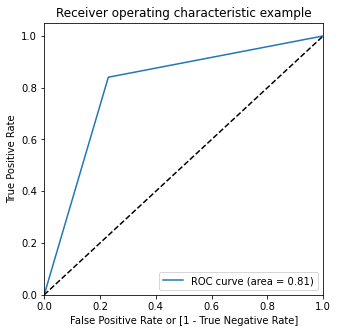

In [321]:
# Calling the function
draw_roc(y_train_pred_RFE.churn_probability, y_train_pred_RFE.Predicted)

In [322]:
# lets Create column with different cutt offs.
numbers = [float(x)/10 for x in range(10)]
for i in numbers:
    y_train_pred_RFE[i]= y_train_pred_RFE.Churn_pred_Prob.map(lambda x: 1 if x>i else 0)

y_train_pred_RFE.head()

,churn_probability,Churn_pred_Prob,id,Predicted,0.0,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9
10661,0,0.000219,10661,0,1,0,0,0,0,0,0,0,0,0
11679,0,0.209008,11679,0,1,1,1,0,0,0,0,0,0,0
19155,0,0.157271,19155,0,1,1,0,0,0,0,0,0,0,0
29423,1,0.936745,29423,1,1,1,1,1,1,1,1,1,1,1
10526,0,0.009224,10526,0,1,0,0,0,0,0,0,0,0,0


##### Calculate Accuracy, Sensitivity and Specificity.

In [323]:
# Now let's calculate accuracy sensitivity and specificity for various probability cutoffs.
cutoff_df = pd.DataFrame( columns = ['prob','accuracy','sensi','speci'])
from sklearn.metrics import confusion_matrix

# TP = confusion[1,1] # true positive 
# TN = confusion[0,0] # true negatives
# FP = confusion[0,1] # false positives
# FN = confusion[1,0] # false negatives

num = [0.0,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9]
for i in num:
    cm1 = metrics.confusion_matrix(y_train_pred_RFE.churn_probability, y_train_pred_RFE[i] )
    total1=sum(sum(cm1))
    accuracy = (cm1[0,0]+cm1[1,1])/total1
    
    speci = cm1[0,0]/(cm1[0,0]+cm1[0,1])
    sensi = cm1[1,1]/(cm1[1,0]+cm1[1,1])
    cutoff_df.loc[i] =[ i ,accuracy,sensi,speci]
print(cutoff_df)

     prob  accuracy     sensi     speci
0.0   0.0  0.501385  1.000000  0.000000
0.1   0.1  0.672056  0.979638  0.362764
0.2   0.2  0.726555  0.956400  0.495433
0.3   0.3  0.762344  0.925744  0.598036
0.4   0.4  0.789821  0.889410  0.689679
0.5   0.5  0.805420  0.840512  0.770132
0.6   0.6  0.807735  0.767845  0.847846
0.7   0.7  0.781927  0.659678  0.904856
0.8   0.8  0.724695  0.497389  0.953265
0.9   0.9  0.581730  0.182272  0.983407


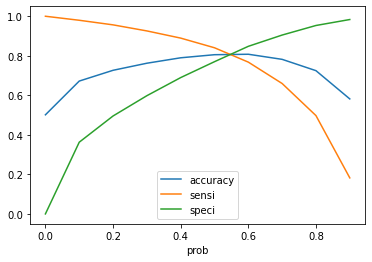

In [324]:
# plotting Accuracy , Sensitivity, Specifcity for different probabilities
cutoff_df.plot.line(x='prob',y= ['accuracy','sensi','speci'])
plt.show()

In [ ]:
## Rerunning the model prediction after getting optimum threshould which is 0.59

In [325]:
# Creating new column 'predicted' with 1 if Churn_Prob > 0.59 else 0
y_train_pred_RFE['predicted'] = y_train_pred_RFE.Churn_pred_Prob.map(lambda x: 1 if x > 0.59 else 0)
y_train_pred_RFE.head()

,churn_probability,Churn_pred_Prob,id,Predicted,0.0,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,predicted
10661,0,0.000219,10661,0,1,0,0,0,0,0,0,0,0,0,0
11679,0,0.209008,11679,0,1,1,1,0,0,0,0,0,0,0,0
19155,0,0.157271,19155,0,1,1,0,0,0,0,0,0,0,0,0
29423,1,0.936745,29423,1,1,1,1,1,1,1,1,1,1,1,1
10526,0,0.009224,10526,0,1,0,0,0,0,0,0,0,0,0,0


In [326]:
# Confusion Matrix
confusion = metrics.confusion_matrix(y_train_pred_RFE.churn_probability, y_train_pred_RFE.predicted)
confusion

array([[11060,  2078],
       [ 2967, 10244]], dtype=int64)

In [327]:
# Lets Check Overall Accuracy 
# Calculate accuracy
print(metrics.accuracy_score(y_train_pred_RFE.churn_probability, y_train_pred_RFE.predicted))

0.8085316330790542


In [328]:
TP = confusion[1,1] # true positive 
TN = confusion[0,0] # true negatives
FP = confusion[0,1] # false positives
FN = confusion[1,0] # false negatives

In [329]:
# Sensitivity 
TP/float(TP+FN)

0.7754144273711301

In [330]:
# Specificity
TN/float(TN+FP)

0.841832851271122

In [331]:
# Precision 
TP/float(TP+FP)

0.8313585456906346

In [332]:
# Recall 
TP/float(TP+FN)

0.7754144273711301

In [ ]:
# Making Prediction on tet set

In [333]:
X_test_sm = sm.add_constant(x_test[col_1])

In [334]:
# Making Prediction on test data set 
y_test_pred = res.predict(X_test_sm)


In [336]:

y_test_pred_RFE = pd.DataFrame({'churn_probability':y_test.values,'Churn_pred_Prob':y_test_pred})
y_test_pred_RFE.head()

,churn_probability,Churn_pred_Prob
2221,1,0.052945
21109,1,0.833978
22947,1,0.856356
20726,1,0.370201
28701,1,0.434815


In [337]:
y_test_pred_RFE['id']= y_test.index
y_test_pred_RFE.head()

,churn_probability,Churn_pred_Prob,id
2221,1,0.052945,2221
21109,1,0.833978,21109
22947,1,0.856356,22947
20726,1,0.370201,20726
28701,1,0.434815,28701


In [338]:
y_test_pred_RFE['Predicted']= y_test_pred_RFE.Churn_pred_Prob.map(lambda x: 1 if x>0.59 else 0)
y_test_pred_RFE

,churn_probability,Churn_pred_Prob,id,Predicted
2221,1,5.294545e-02,2221,0
21109,1,8.339776e-01,21109,1
22947,1,8.563562e-01,22947,1
20726,1,3.702014e-01,20726,0
28701,1,4.348151e-01,28701,0
35421,1,6.529282e-01,35421,1
33185,1,8.467163e-01,33185,1
21411,1,9.549326e-01,21411,1
34602,1,7.040842e-01,34602,1
30294,1,9.017329e-01,30294,1


In [340]:
# Confusion Matrix
confusion = metrics.confusion_matrix(y_test_pred_RFE.churn_probability, y_test_pred_RFE.Predicted)
confusion

array([[4761,  922],
       [1198, 4412]], dtype=int64)

In [341]:
# Lets Check Overall Accuracy 
# Calculate accuracy
print(metrics.accuracy_score(y_test_pred_RFE.churn_probability, y_test_pred_RFE.Predicted))

0.8122730895244842


In [342]:
TP = confusion[1,1] # true positive 
TN = confusion[0,0] # true negatives
FP = confusion[0,1] # false positives
FN = confusion[1,0] # false negatives

In [343]:
# Sensitivity 
TP/float(TP+FN)

0.7864527629233512

In [344]:
# Specificity
TN/float(TN+FP)

0.8377617455569242

In [345]:
# Precision 
TP/float(TP+FP)

0.8271466066741657

In [346]:
# Recall 
TP/float(TP+FN)

0.7864527629233512

# Prediction on unseen data 

In [347]:
# Getting the predicted value on  unseen data 
y_unseen_pred = res.predict(sm.add_constant(High_val_cust_unseen_W_id[col_1]))
y_unseen_pred.head()

0    0.725249
1    0.452356
2    0.824359
3    0.430822
4    0.462029
dtype: float64

In [348]:
High_val_cust_unseen['Pred_churn_probability']= y_unseen_pred
output = High_val_cust_unseen[['id','Pred_churn_probability']]
output.head()

,id,Pred_churn_probability
0,69999,0.725249
1,70000,0.452356
2,70001,0.824359
3,70002,0.430822
4,70003,0.462029


In [349]:
# now lets convert probability prediction into class 0 and 1 
# and add final column 'churn_probability' as per threshould obtain which is 0.59

output['churn_probability'] = output.Pred_churn_probability.map(lambda x: 1 if x>0.59 else 0)
output.head()

,id,Pred_churn_probability,churn_probability
0,69999,0.725249,1
1,70000,0.452356,0
2,70001,0.824359,1
3,70002,0.430822,0
4,70003,0.462029,0


In [350]:
# dropping 'Pred_churn_probability' as not required in submission file
submision_RFE = output.drop('Pred_churn_probability', axis=1)
submision_RFE.head()

,id,churn_probability
0,69999,1
1,70000,0
2,70001,1
3,70002,0
4,70003,0


In [351]:
# converting to csv file
submision_RFE.to_csv(r'C:\Users\pc\OneDrive\Desktop\Kaggle_project\submission_RFE.csv',index=False)